# Cluster Explanation

## <u> Table of Contents </u>
* [Import the Dataset](#1)
* [PCA Models](#2)
    * [Zero Dataset](#3)
        * [Visualisation](#5)
        * [Customer Distribution](#6)
        * [Distribution of Financial Features](#7)
        * [Distribution of Non-Financial Features ](#8)
    * [Nonzero Dataset ](#9)
        * [Visualisation](#10)
        * [Customer Distribution](#11)
        * [Distribution of Financial Features](#12)
        * [Distribution of Non-Financial Features](#13)
* [UMAP Models](#14)
    * [Zero Model](#15)
        * [Visualisation](#16)
        * [Customer Distribution](#17)
        * [Distribution of Financial Features](#18)
        * [Distribution of Non-Financial Features ](#19)
    * [Nonzero Dataset ](#19)
        * [Visualisation](#21)
        * [Customer Distribution](#22)
        * [Distribution of Financial Features](#23)
        * [Distribution of Non-Financial Features ](#24)


<br>

## Import the DataSet  <a class="anchor" id="1"></a>

In [1]:
#!pip install plotly
#!pip install joypy
#!pip install pyvis
#!pip install prince
#!pip install pyclustering
#!pip install clusteval
#!pip install kmodes
#!pip install gower
#!pip install scikit-learn-extra
#!pip install minisom
#!pip install fuzzy-c-means
#!pip install -U kaleido
#!pip uninstall umap-learn
#!pip install umap

In [2]:
# Remove the warnings

import warnings; warnings.simplefilter('ignore')

# Basic Packages

import pandas as pd
import numpy as np
from numpy import asarray
from numpy import save
import random

# Set a random state 

np.random.seed(9)

# Notebook Setup

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "last"
pd.set_option('display.max_columns', None)

# Plotting Packages

import matplotlib
import matplotlib.pyplot as plt
%matplotlib inline 
import seaborn as sns
from matplotlib.widgets import SpanSelector
from bokeh.models import Div, RangeSlider, Spinner
from bokeh.plotting import figure, show
import plotly.express as px
import plotly as py
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
from joypy import joyplot
from pyvis.network import Network
from IPython.display import Image
import plotly.offline as pyo

# Set notebook mode to work in offline

pyo.init_notebook_mode()

# Packages for Transformations

import scipy.special
import prince
from sklearn.preprocessing import PowerTransformer
from scipy import stats
from sklearn.preprocessing import OrdinalEncoder
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
import umap.umap_ as UMAP
#import umap
from sklearn.impute import KNNImputer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import pairwise_distances


# Packages for Clustering

from pyclustering.cluster.center_initializer import kmeans_plusplus_initializer
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import davies_bouldin_score
from sklearn.cluster import KMeans
from clusteval import clusteval
from kmodes.kmodes import KModes
from sklearn.cluster import AgglomerativeClustering 
import gower
from sklearn_extra.cluster import KMedoids
from sklearn.cluster import DBSCAN
from minisom import MiniSom
from sklearn.cluster import Birch
import scipy.cluster.hierarchy as shc
from fcmeans import FCM
from sklearn.ensemble import RandomForestClassifier
from kmedoids import fasterpam

# Packages to measure performance

from sklearn.metrics import silhouette_samples
from sklearn.metrics import silhouette_score
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import davies_bouldin_score
from scipy.spatial import distance as ssd
from pyclustering.cluster.kmedoids import kmedoids

In [3]:
# Import the zero dataset and remove unwanted columns

final_zero = pd.read_csv('/Users/cirillogirardi/Desktop/Dissertation/final_zero.csv')
final_zero.drop(columns=['Unnamed: 0'], inplace=True)
tra_zero = pd.read_csv('/Users/cirillogirardi/Desktop/Dissertation/tra_zero.csv')
tra_zero.drop(columns=['Unnamed: 0'], inplace=True)
zero_df = pd.read_csv('/Users/cirillogirardi/Desktop/Dissertation/zero_df.csv')
zero_df.drop(columns=['Unnamed: 0'], inplace=True)

# Import the nonzero dataset and remove unwanted columns

final_nonzero = pd.read_csv('/Users/cirillogirardi/Desktop/Dissertation/final_nonzero.csv')
final_nonzero.drop(columns=['Unnamed: 0'], inplace=True)
tra_nonzero = pd.read_csv('/Users/cirillogirardi/Desktop/Dissertation/tra_nonzero.csv')
tra_nonzero.drop(columns=['Unnamed: 0'], inplace=True)
nonzero_df = pd.read_csv('/Users/cirillogirardi/Desktop/Dissertation/nonzero_df.csv')
nonzero_df.drop(columns=['Unnamed: 0'], inplace=True)

In [4]:
# check if the finalzero dataset is correct

final_zero.head(1)

,volume_firm,liabilities_firm,bank_liabilities,other_liabilities,pl,banking_products,new_active_cc,new_passive_cc,new_commission_income,legal,p_membership,p_KK,p_fixeddeposits,p_propertyinsurance,p_companyinsurance,p_DZ,p_unionfunds,p_buildingsavings,p_mortgage,p_VRleasing,p_teambank,work,year,risk,postcode
0,-0.919737,-1.221589,-1.39815,-0.213653,-0.611916,-0.341303,-0.432425,-0.13513,-0.181772,16.0,1.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,208.0,13.0,1.0,32.0


In [5]:
# check if the transformed zero dataset is correct

tra_zero.head(1)

,client_type,legal,branch,volume_firm,liabilities_firm,liabilities,bank_liabilities,other_liabilities,pl_firm,pl,banking_products,other_products,p_membership,p_KK,p_creditcard,p_bankloans,p_fixeddeposits,p_WP2Depot,p_propertyinsurance,p_companyinsurance,p_DZ,p_DZP,p_unionfunds,p_buildingsavings,p_mortgage,p_VRleasing,p_teambank,new_active_cc,new_passive_cc,new_commission_income,new_cmib,work,year,risk,postcode,size
0,0.0,16.0,10.0,10.103612,9.181565,0.0,0.0,-11.512925,12.735183,14.697371,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-0.0,0.050022,26.431755,3.856511,208.0,13.0,1.0,32.0,1.0


In [6]:
# check if the original zero dataset is correct

zero_df.head(1)

,client_type,legal,branch,volume_firm,volume,loans_approved,loans_utilized,liabilities_firm,liabilities,bank_liabilities,other_liabilities,pl_firm,pl,banking_products,other_products,p_membership,p_KK,p_creditcard,p_bankloans,p_fixeddeposits,p_WP2Depot,p_propertyinsurance,p_companyinsurance,p_DZ,p_DZP,p_unionfunds,p_buildingsavings,p_mortgage,p_VRleasing,p_teambank,new_active_cc,new_passive_cc,new_commission_income,new_cmib,work,year,risk,postcode,size
0,0.0,16.0,10.0,31792.82,0.0,0.0,0.0,6103.29,0.0,0.0,0.0,47870.67,11518.478,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.05,47.25,47.3,208.0,13.0,1.0,32.0,1.0


In [7]:
# check if the final nonzero dataset is correct

final_nonzero.head(1)

,loans_approved,bank_liabilities,other_liabilities,pl,banking_products,new_active_cc,new_commission_income,client_type,legal,p_membership,p_KK,p_creditcard,p_fixeddeposits,p_WP2Depot,p_propertyinsurance,p_companyinsurance,p_DZ,p_mortgage,p_VRleasing,p_teambank,work,year,risk,postcode
0,-0.428154,-0.57338,-0.426741,-1.530136,-0.458714,0.300147,-0.464326,0.0,39.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,393.0,11.0,0.0,46.0


In [8]:
# check if the transformed nonzero dataset is correct

tra_nonzero.head(1)

,client_type,legal,branch,volume_firm,volume,loans_approved,loans_utilized,liabilities_firm,liabilities,bank_liabilities,other_liabilities,pl_firm,pl,banking_products,other_products,p_membership,p_KK,p_creditcard,p_bankloans,p_fixeddeposits,p_WP2Depot,p_propertyinsurance,p_companyinsurance,p_DZ,p_DZP,p_unionfunds,p_buildingsavings,p_mortgage,p_VRleasing,p_teambank,new_active_cc,new_passive_cc,new_commission_income,new_cmib,work,year,risk,postcode,size
0,0.0,39.0,23.0,8.333568,7.697297,9.93363,10.883836,7.523551,10.231201,9.80453,-0.0,7.444261,9.518547,2.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,5.180153,2.5096,13.890309,5.466413,393.0,11.0,0.0,46.0,1.0


In [9]:
# check if the original nonzero dataset is correct

nonzero_df.head(1)

,client_type,legal,branch,volume_firm,volume,loans_approved,loans_utilized,liabilities_firm,liabilities,bank_liabilities,other_liabilities,pl_firm,pl,banking_products,other_products,p_membership,p_KK,p_creditcard,p_bankloans,p_fixeddeposits,p_WP2Depot,p_propertyinsurance,p_companyinsurance,p_DZ,p_DZP,p_unionfunds,p_buildingsavings,p_mortgage,p_VRleasing,p_teambank,new_active_cc,new_passive_cc,new_commission_income,new_cmib,work,year,risk,postcode,size
0,0.0,39.0,23.0,12988.79,12988.79,12988.79,12988.79,748.17,748.17,748.17,0.0,7388.77,7388.77,2.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,177.71,12.3,46.6,236.61,393.0,11.0,0.0,46.0,1.0


<br>
<br>

Within the previous Notebooks, the models were run on both the Orginal Datasets and the dimensionally reduced datasets. Following an analysis of their results 4 models were selected as the best performing. Two types of models were applied on datasets reduced with Principal Component Analysis. These models were: K-Means and Fuzzy C-Means. Other two models were applied on datasets reduced with UMAP. The models were Agglomerative Clustering and FasterPAM. <br><br>
All four models depicted incredible results on both the zero and nonzero datasets, especially when considering how initially skwewed the features were. Within this Notebook the models will be depicted in a graphical format in order to provide visual aids to comprehend how said models can be applied within a corporate context.

# PCA  Models <a class="anchor" id="2"></a>


Foremost we have to reduce the datasets using Principal Component Analysis to run the following models: K-Means and Fuzzy C-Means <br>

In [10]:
# We define the PCA algorithm with a number of compnents that can explain 90% of the variance

pca = PCA(n_components=0.90)

# Zero Dataset
# we apply pca to the zero dataset

PCA_zero = pca.fit_transform(final_zero)

# Nonzero Dataset
# we apply pca to the non-zero dataset

PCA_nonzero = pca.fit_transform(final_nonzero)

In [11]:
# We then define a PCA with two components for visual purposes

pca_2d = PCA(n_components=2)

# We then define a PCA with three components for visual purposes

pca_3d = PCA(n_components =3)

## Apply the models to the Datasets

### Zero Dataset  <a class="anchor" id="3"></a>

#### K-Means   <a class="anchor" id="4"></a>

The former model selected was the K-Means. This model performed best on the Zero Dataset, efficiently segmenting the clients within 13 categories.

In [12]:
# we define the model and the respective parameters

k_model_PCA_zero = KMeans(algorithm='elkan', copy_x=True, init='k-means++', max_iter=1000, 
                 n_clusters=13, n_init=100, random_state=9, tol=0.0001, verbose=0)

# Fit the function to the PCA zero dataset

k_model_PCA_zero.fit(PCA_zero)
k_model_PCA_zero.cluster_centers_

# Assign the labels to the respective rows and further view the cluster segmentation 

final_zero['Cluster_k_PCA'] = k_model_PCA_zero.labels_
tra_zero['Cluster_k_PCA'] = k_model_PCA_zero.labels_

zero_df["Cluster_k_PCA"] = k_model_PCA_zero.labels_
print('Distribution of Clusters: \n')
print(zero_df['Cluster_k_PCA'].value_counts())

Distribution of Clusters: 

5     2015
0     1034
7      409
6      346
3      276
2      226
4      197
8      188
11     178
12      99
1       82
10      70
9       66
Name: Cluster_k_PCA, dtype: int64


As a recap we depict the results of the model.

In [13]:
print('The PCA performance scores are the following: \n' )
print('13 Clusters')
print('Silhouette: ' + str(silhouette_score(PCA_zero, k_model_PCA_zero.labels_ , metric='euclidean')))
print('Calinski Harabasz: ' + str(calinski_harabasz_score(PCA_zero, k_model_PCA_zero.labels_ )))
print('Davies Bouldin: ' + str(davies_bouldin_score(PCA_zero, k_model_PCA_zero.labels_)))

The PCA performance scores are the following: 

13 Clusters
Silhouette: 0.8010363750854433
Calinski Harabasz: 147964.2415017464
Davies Bouldin: 0.36936269968319874


As can be seen, both the Silhouette and the Calinski Harabasz scores are extremely high, entailing good inter-cluster similarities and robust intra-cluster differences. We then visualise the clusters in a PCA reduced plot.

#### Visualisation  <a class="anchor" id="5"></a>

In [14]:
# we remove the clusters from a new dataset

tt = tra_zero.drop(columns=['Cluster_k_PCA'])

# we create two dfs, one for 2 components and one for 3

PCs_2d = pd.DataFrame(pca_2d.fit_transform(tt))
PCs_3d = pd.DataFrame(pca_3d.fit_transform(tt))


# PC1_2d: The first component. PC2_2d: The second component, etc-

PCs_2d.columns = ["PC1_2d", "PC2_2d"]

PCs_3d.columns = ["PC1_3d", "PC2_3d", "PC3_3d"]

# we create a new df

tra_zero1 = tra_zero.copy()

# we concatonate all dfs together to then derive visuals

tra_zero1 = pd.concat([tra_zero1,PCs_2d,PCs_3d], axis=1, join='inner')

In [15]:
# we create a new variable for each cluster in the dataset so we create two empty lists

cluster = []
idd = []

# we then create a loop to iterate through the values

for i in tra_zero1["Cluster_k_PCA"].value_counts().index:
    n = i
    id_ = 'cluster_' + str(n) # for each id we create a new variable
    m = str(id_) +  ' = ' + 'tra_zero1[tra_zero1["Cluster_k_PCA"] == ' + str(n) + ']' # we then define the variable 
    idd.append(id_) # we append its id to the list
    cluster.append(m) # we append the variable to the list

# we then create a loop to execute all of the new variables created
    
for i in cluster:
    exec(i)

    
# we create two new lists, one to contain the different PCA plots, the other to store the trace (i.e. id of the plot)
    
nn = []
l = []    
for i in idd:
    b = 'trace' + i 
    p = 'go.Scatter(x =' + i + '["PC1_2d"], y =' + i + '["PC2_2d"], mode = "markers", text = None)'
    l.append(b)
    nn.append(p)
    
# we create a dictionary to ensure that all traces are correctly defined  
    
commands = {}
for a,b in zip(nn,l):
    key=str(b)
    commands[key]=a

# we execute the dictionary and create the individual plots  
    
for key, value in commands.items():
    exec (f'{key}={value}')            
   

In [16]:
# we retrieve all the new features

for i in l:
    print(i)

tracecluster_5
tracecluster_0
tracecluster_7
tracecluster_6
tracecluster_3
tracecluster_2
tracecluster_4
tracecluster_8
tracecluster_11
tracecluster_12
tracecluster_1
tracecluster_10
tracecluster_9


In [17]:
# we set a title for the graph

title = "Visualizing Clusters in Two Dimensions Using PCA"


# we set an appropriate layout 

layout = dict(title = title,
              xaxis= dict(title= 'P1',ticklen= 5,zeroline= False),
              yaxis= dict(title= 'P2',ticklen= 5,zeroline= False)
             )

# we zip all the traces to create one figure

fig = go.Figure(dict(data = [tracecluster_5,
tracecluster_0,
tracecluster_7,
tracecluster_6,
tracecluster_3,
tracecluster_2,
tracecluster_4,
tracecluster_8,
tracecluster_11,
tracecluster_12,
tracecluster_1,
tracecluster_10,
tracecluster_9]), layout = layout)

pyo.iplot(fig)

# we save the dataset
    
#fig.write_image("Kmeans_orig_2_Z.png", scale=2)

In [18]:
nn = []
l = []    
for i in idd:
    b = 'trace' + i 
    p = 'go.Scatter3d(x =' + i + '["PC1_2d"], y =' + i + '["PC2_2d"], z =' + i + '["PC3_3d"], mode = "markers", text = None)'
    l.append(b)
    nn.append(p)
    
commands = {}
for a,b in zip(nn,l):
    key=str(b)
    commands[key]=a
            
for key, value in commands.items():
    exec (f'{key}={value}')     

In [19]:
for i in l:
    print(i)

tracecluster_5
tracecluster_0
tracecluster_7
tracecluster_6
tracecluster_3
tracecluster_2
tracecluster_4
tracecluster_8
tracecluster_11
tracecluster_12
tracecluster_1
tracecluster_10
tracecluster_9


In [20]:
# we set a title for the graph

title = "Visualizing Clusters in Three Dimensions Using PCA"


# we set an appropriate layout 

layout = dict(title = title,
              xaxis= dict(title= 'P1',ticklen= 5,zeroline= False),
              yaxis= dict(title= 'P2',ticklen= 5,zeroline= False)
             )

# we zip all the traces to create one figure

fig = go.Figure(dict(data = [tracecluster_5,
tracecluster_0,
tracecluster_7,
tracecluster_6,
tracecluster_3,
tracecluster_2,
tracecluster_4,
tracecluster_8,
tracecluster_11,
tracecluster_12,
tracecluster_1,
tracecluster_10,
tracecluster_9]), layout = layout)

pyo.iplot(fig)

# we save the dataset

#fig.write_image("Kmeans_orig_3_Z.png", scale=2)

As can be seen by the two dimensional and three dimensional plots, the clusters are well separated and densely distributed. Therefore, this represents an extremely efficient solution

Next we determine the distribution of customers.

#### Customer Distribution  <a class="anchor" id="6"></a>

In [21]:
# select the most relevant features for illustrative purposes

feat_1 = ['legal', 'volume_firm', 'loans_utilized', 'liabilities',
       'bank_liabilities', 'pl','banking_products', 'other_products',
       'new_commission_income', 'new_cmib', 'year', 'risk', 'postcode',
       'size','Cluster_k_PCA']

In [22]:
# Group the observations by cluster and depict the means

desc_1 = zero_df[feat_1].groupby('Cluster_k_PCA').mean().T
desc_1.iloc[:,:7]

Cluster_k_PCA,0,1,2,3,4,5,6
legal,1.577756e+01,19.731707,23.115044,1.423913e+01,1.887310e+01,6.739454e+00,1.400289e+01
volume_firm,5.174833e+07,821783.490854,942302.290664,2.402643e+06,7.800669e+06,3.094152e+06,1.442815e+06
loans_utilized,1.343448e+02,5.290854,16.449204,2.655543e+00,2.400152e+00,4.684903e+01,8.151540e+01
liabilities,9.582019e+04,197341.389268,47662.082080,5.892485e+04,5.884377e+04,1.798706e+05,3.748035e+04
bank_liabilities,9.194069e+04,195947.369390,46223.608186,5.330703e+04,5.773078e+04,1.783458e+05,3.455197e+04
pl,6.433767e+05,535263.636488,197108.271168,3.537058e+05,2.468958e+06,3.102929e+05,2.354348e+05
banking_products,7.656673e+00,1.280488,1.924779,1.619565e+00,1.116751e+00,2.893300e+00,3.375723e+00
other_products,5.029014e-02,0.036585,0.132743,3.297101e-01,1.167513e-01,9.429280e-02,2.947977e-01
new_commission_income,1.806852e+02,336.947927,53.283717,1.802248e+02,2.198842e+02,1.141621e+02,1.349348e+02
new_cmib,5.327247e+02,730.881829,347.100708,3.449345e+02,5.410113e+02,9.321050e+02,3.196665e+02


The means of the respective clusters are well defined and differ in range. Consequentially the clusters factually represent different categories of clients. When observing the most important features, the financial features, it can be seen that the model did an extremely good job in classifying individuals.

##### Distribution of Financial Features  <a class="anchor" id="7"></a>

Next we visualise the feature distribution. Since  bank is primarily concerned with the financial characteristics of the clients, these shall be depicted first.

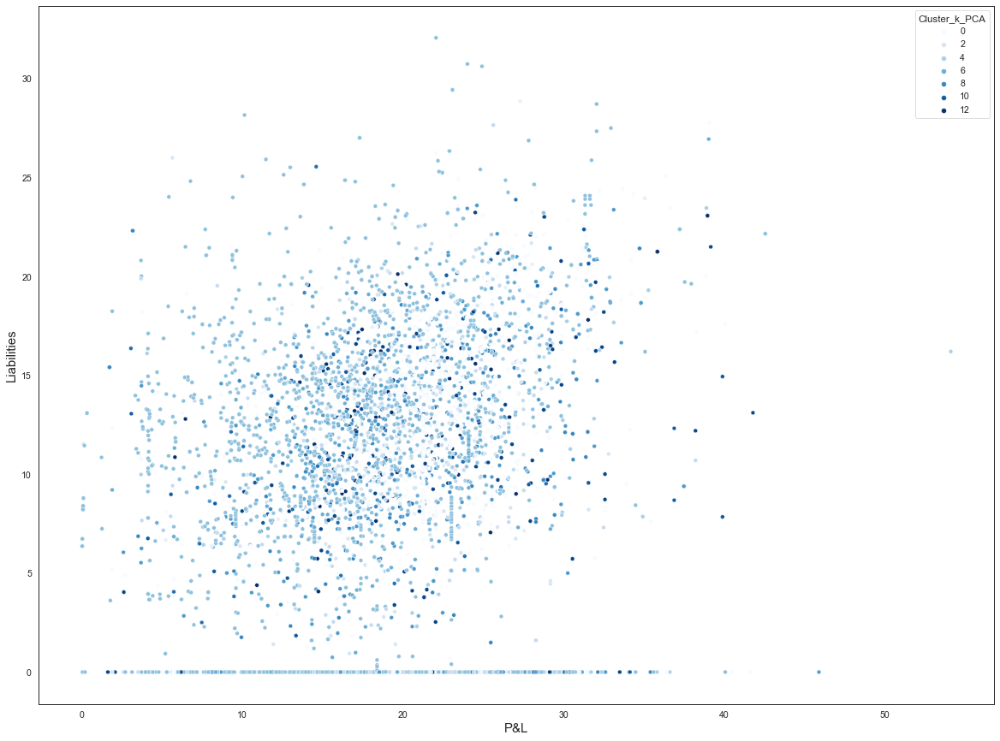

In [23]:
# set the basic format (i.e. the palette for the color and the backgrounds)
sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot
fig, ax = plt.subplots(figsize=(20,15))


# create the scatterplot and set the font
j= sns.scatterplot(data=tra_zero, x='pl', y='liabilities', hue='Cluster_k_PCA', palette=('Blues'), ax=ax)
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot
ax.set_xlabel('P&L', fontsize = 15)
ax.set_ylabel('Liabilities', fontsize = 15)

plt.show()

Text(27.075000000000003, 0.5, 'P&L')

<Figure size 1440x1080 with 0 Axes>

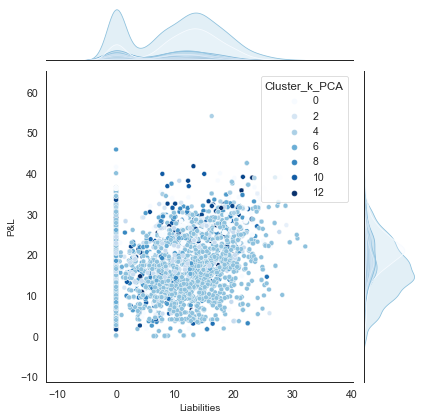

In [24]:
# set the basic format (i.e. the palette for the color and the backgrounds)
sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

plt.figure(figsize=(20,15))

# create the jointplot and set the labels

j = sns.jointplot(data=tra_zero, x="liabilities", y="pl", hue="Cluster_k_PCA", palette=('Blues'))
j.ax_joint.set_xlabel('Liabilities', fontsize = 10)
j.ax_joint.set_ylabel('P&L', fontsize = 10)

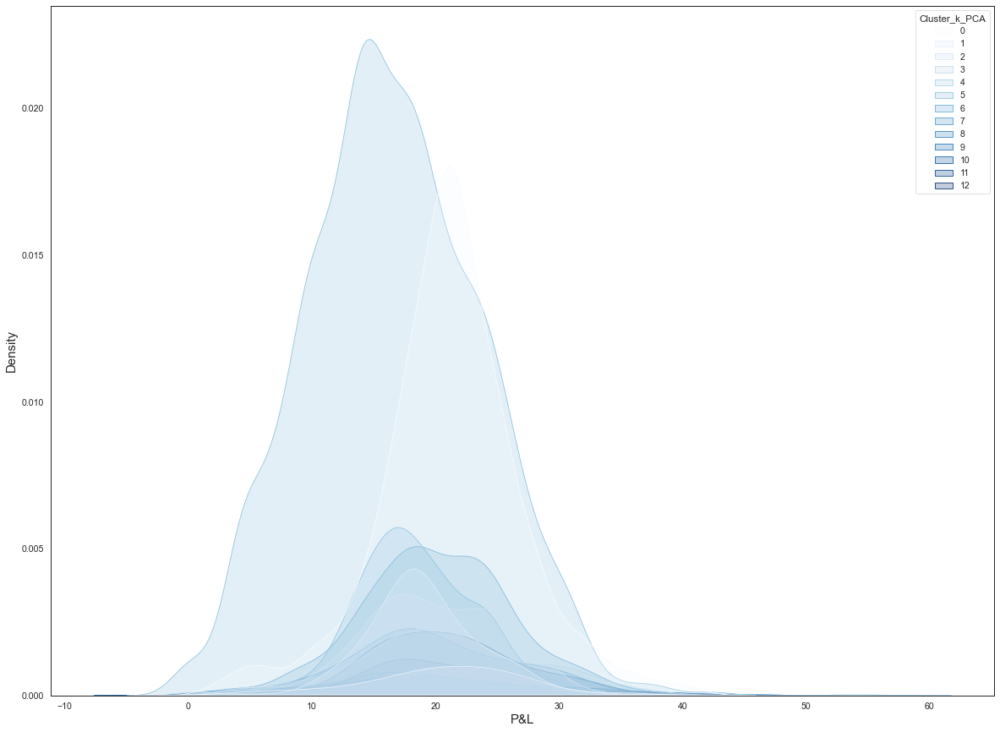

In [25]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the kdeplot and set the font

j= sns.kdeplot(data=tra_zero, x="pl", hue="Cluster_k_PCA", palette=('Blues'), shade=True)
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('P&L', fontsize = 15)
ax.set_ylabel('Density', fontsize = 15)

#plt.savefig('PL_kmean.png', dmi=1200)

plt.show()

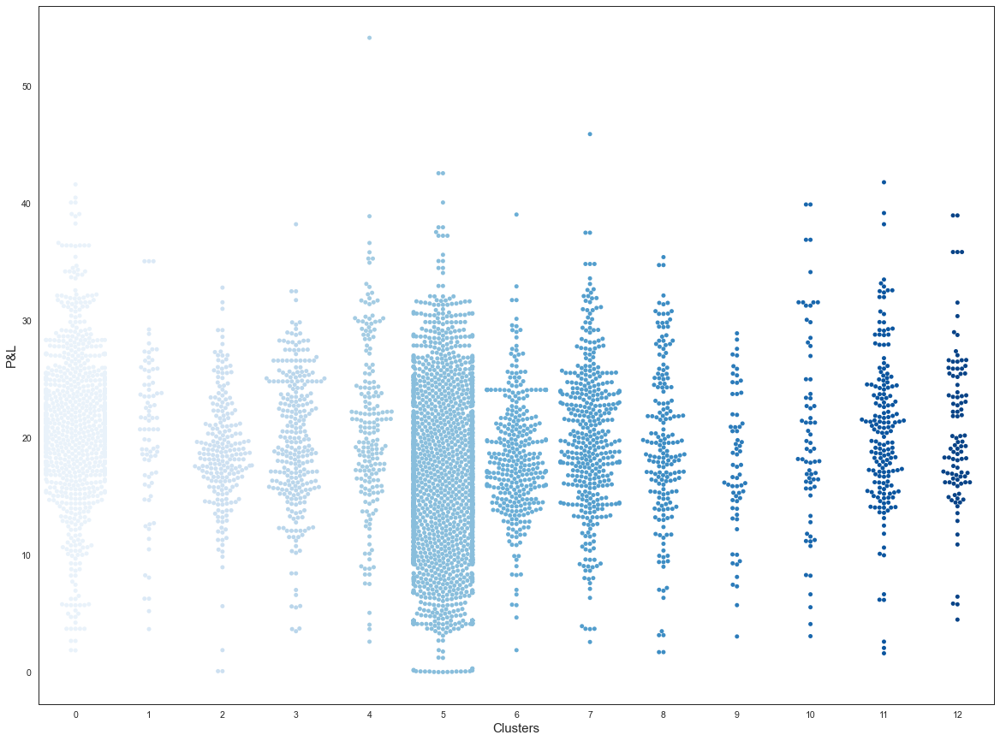

In [26]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_zero, x="Cluster_k_PCA", y="pl",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('P&L', fontsize = 15)

#plt.savefig('PL_kmean2.png', dmi=1200)

plt.show()

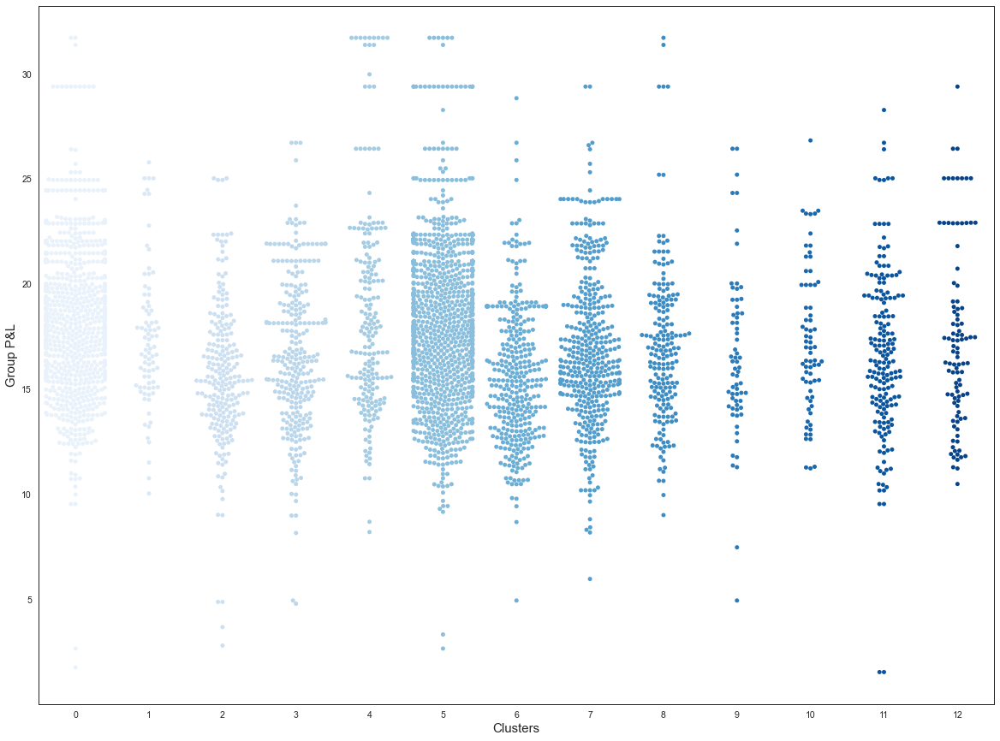

In [27]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_zero, x="Cluster_k_PCA", y="pl_firm",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot 

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Group P&L', fontsize = 15)

plt.show()

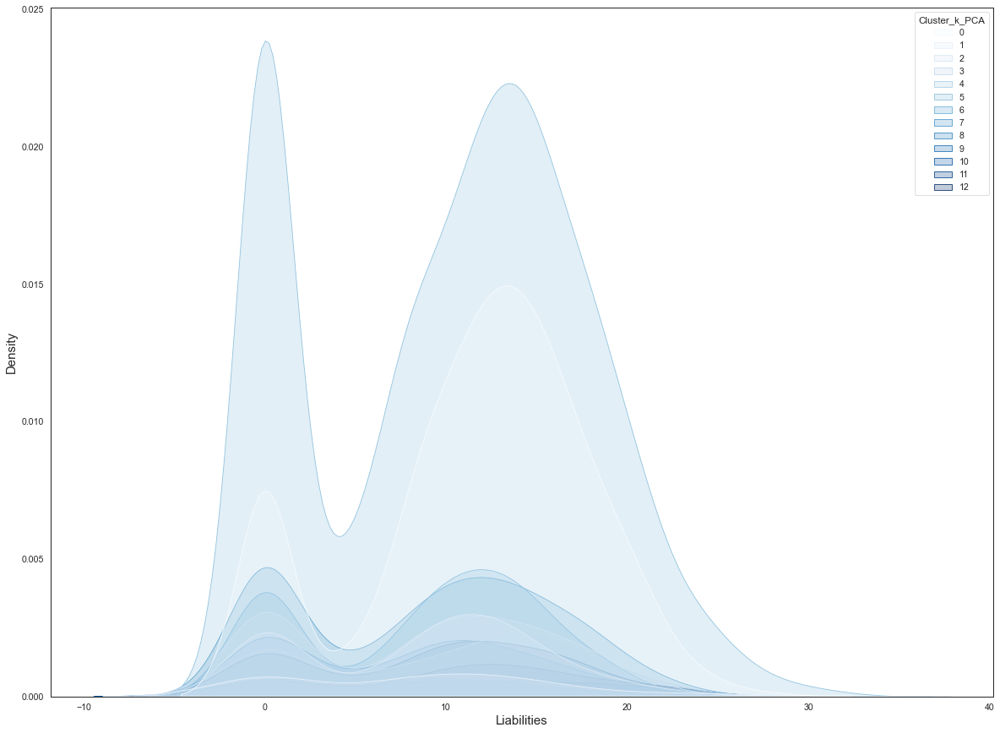

In [28]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the kdeplot and set the font

j= sns.kdeplot(data=tra_zero, x="liabilities", hue="Cluster_k_PCA", palette=('Blues'), shade=True)
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Liabilities', fontsize = 15)
ax.set_ylabel('Density', fontsize = 15)

plt.show()

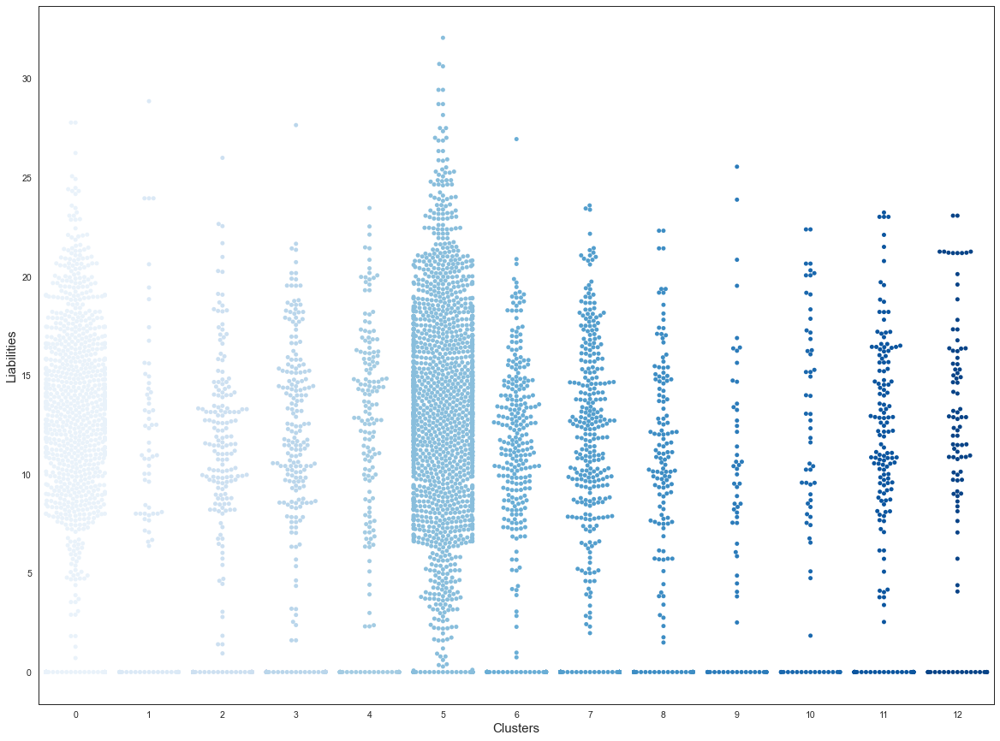

In [29]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_zero, x="Cluster_k_PCA", y="liabilities",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Liabilities', fontsize = 15)

plt.show()

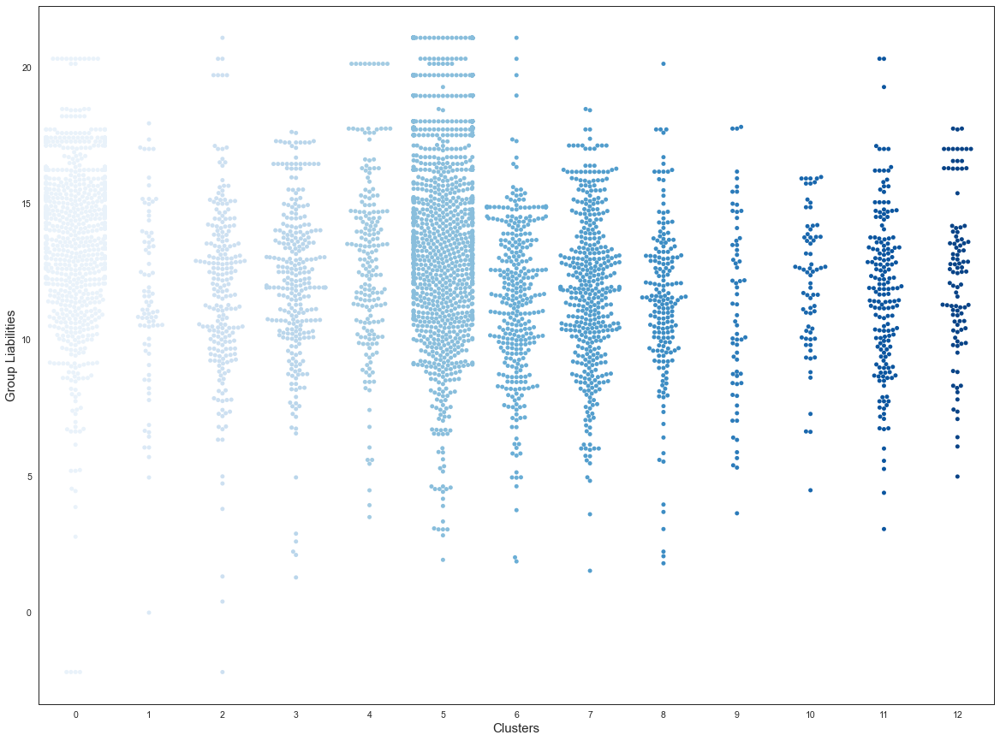

In [30]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


# create the swarmplot and set the font

j= sns.swarmplot(data=tra_zero, x="Cluster_k_PCA", y="liabilities_firm",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Group Liabilities', fontsize = 15)

plt.show()

#### Distribution of Non-Financial Features   <a class="anchor" id="8"></a>

Next we depict the most important non-financial features. These provide a different angle to understand the types of clients present within the clusters

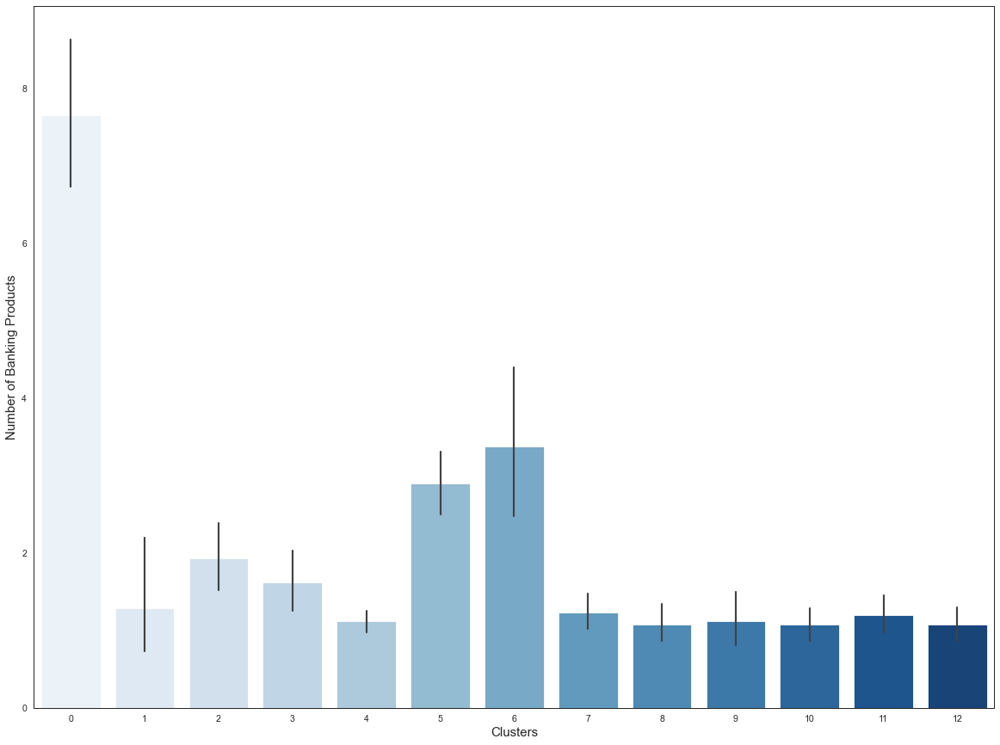

In [31]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


# create the barplot and set the font

j= sns.barplot(x ='Cluster_k_PCA', y ='banking_products', data = tra_zero, palette ='Blues')
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Number of Banking Products', fontsize = 15)

plt.show()



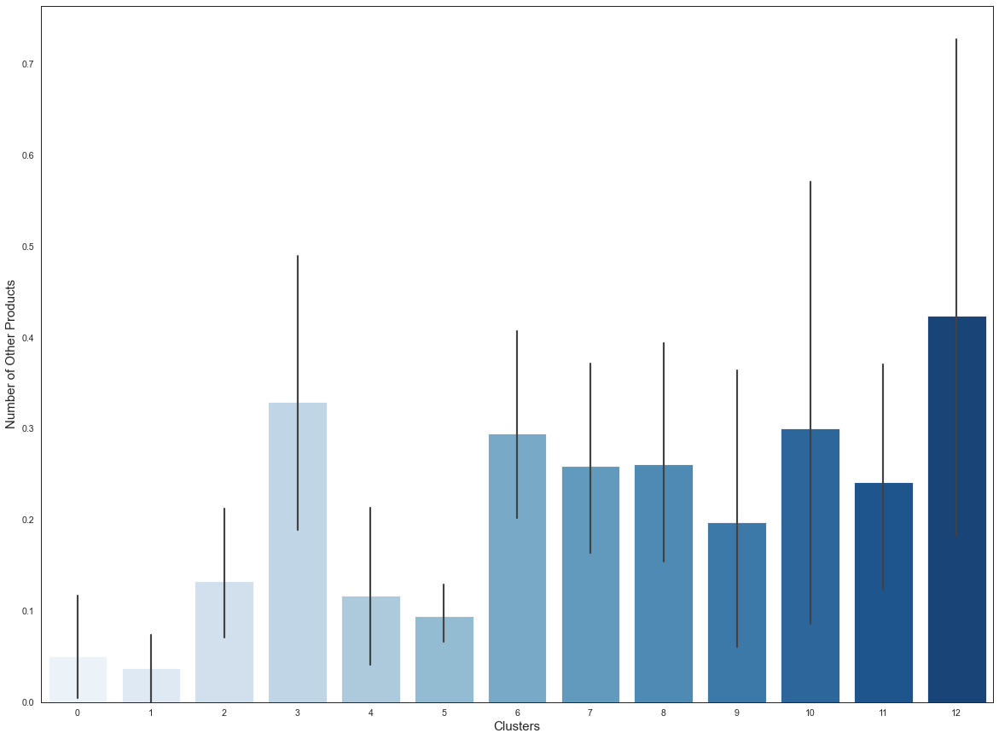

In [32]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the barplot and set the font

j= sns.barplot(x ='Cluster_k_PCA', y ='other_products', data = tra_zero, palette ='Blues')
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Number of Other Products', fontsize = 15)

plt.show()

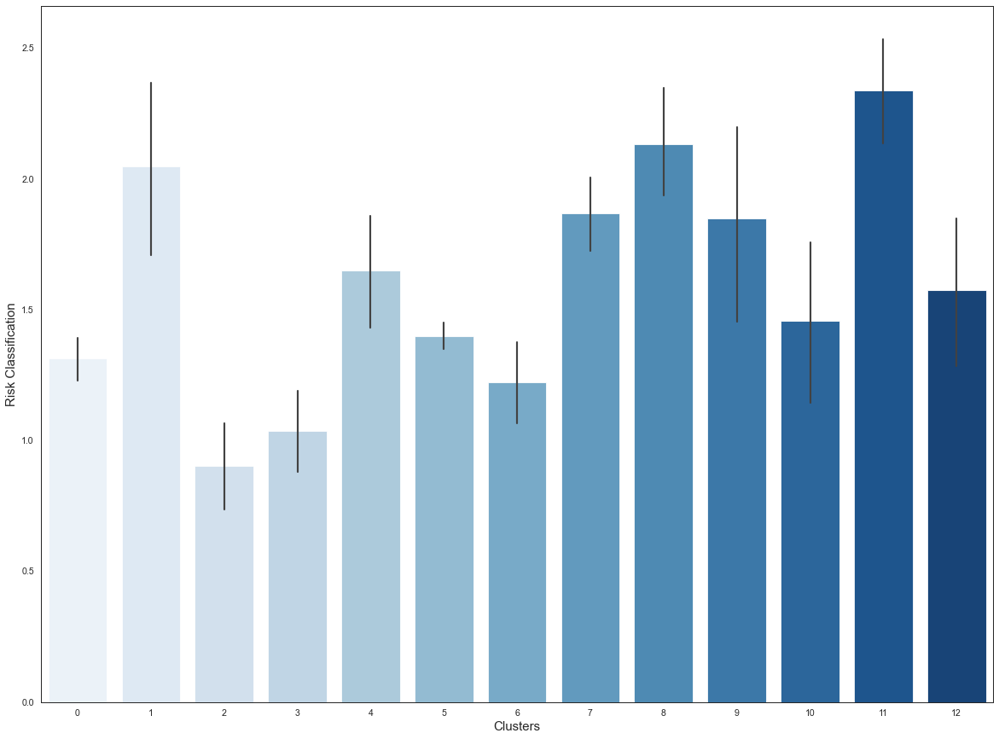

In [33]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


# create the barplot and set the font

j= sns.barplot(x ='Cluster_k_PCA', y ='risk', data = tra_zero, palette ='Blues')
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Risk Classification', fontsize = 15)

plt.show()

### Nonzero Dataset    <a class="anchor" id="9"></a>

Next we consider the Fuzzy C-Means model on the nonzero dataset. This model also performed extremely well, segmenting a very large dataset in 11 categories. Furthermore, the model maintained very high scores for intra-cluster difference, suggesting that despite the very densely distributed categories, the algorithm was very efficient in selecting the clients.

#### Fuzzy C-Means

In [34]:
# we define the model and the respective parameters

fcm_PCA_nonzero_25 = FCM(n_clusters=11, m=2.0, max_iter=1000, random_state=9)

# Fit the function to the zero dataset and retrieve the labels

fcm_PCA_nonzero_25.fit(PCA_nonzero)

labelss25_PCA = fcm_PCA_nonzero_25.predict(PCA_nonzero)

# Assign the labels to the respective rows and further view the cluster segmentation 

final_nonzero["Cluster_f25"] = labelss25_PCA
tra_nonzero["Cluster_f25"] = labelss25_PCA

nonzero_df["Cluster_f25"] = labelss25_PCA
print('Values for when m = 2.5')
print('\n')
print(nonzero_df['Cluster_f25'].value_counts())

Values for when m = 2.5


2     2641
7     2093
10    1830
6     1510
0     1384
9      883
1      794
3      786
4      763
5      708
8      415
Name: Cluster_f25, dtype: int64


We provide the results for the model

In [35]:
print('The PCA performance scores are the following: \n' )
print('M: 2.0')
print('Silhouette: ' + str(silhouette_score(PCA_nonzero, labelss25_PCA, metric='euclidean')))
print('Calinski Harabasz: ' + str(calinski_harabasz_score(PCA_nonzero, labelss25_PCA)))
print('Davies Bouldin: ' + str(davies_bouldin_score(PCA_nonzero, labelss25_PCA)))

The PCA performance scores are the following: 

M: 2.0
Silhouette: 0.7298449543841512
Calinski Harabasz: 236808.48191542857
Davies Bouldin: 0.3844152273065238


#### Visualisation  <a class="anchor" id="10"></a>

We then plot the results in a two and three dimensional plot utilising Principal Component Analysis.

In [36]:
# we remove the clusters from a new dataset

tt = tra_nonzero.drop(columns=['Cluster_f25'])

# we create two dfs, one for 2 components and one for 3

PCs_2d = pd.DataFrame(pca_2d.fit_transform(tt))
PCs_3d = pd.DataFrame(pca_3d.fit_transform(tt))


# PC1_2d: The first component. PC2_2d: The second component, etc-

PCs_2d.columns = ["PC1_2d", "PC2_2d"]

PCs_3d.columns = ["PC1_3d", "PC2_3d", "PC3_3d"]

# we create a new df

tra_nonzero1=tra_nonzero.copy()

# we concatonate all dfs together to then derive visuals

tra_nonzero1 = pd.concat([tra_nonzero1,PCs_2d,PCs_3d], axis=1, join='inner')

In [37]:
# we create a new variable for each cluster in the dataset so we create two empty lists

cluster = []
idd = []

# we then create a loop to iterate through the values

for i in tra_nonzero1["Cluster_f25"].value_counts().index:
    n = i
    id_ = 'cluster_' + str(n) # for each id we create a new variable
    m = str(id_) +  ' = ' + 'tra_nonzero1[tra_nonzero1["Cluster_f25"] == ' + str(n) + ']' # we then define the variable 
    idd.append(id_) # we append its id to the list
    cluster.append(m) # we append the variable to the list

# we then create a loop to execute all of the new variables created
    
for i in cluster:
    exec(i)

    
# we create two new lists, one to contain the different PCA plots, the other to store the trace (i.e. id of the plot)
    
nn = []
l = []    
for i in idd:
    b = 'trace' + i 
    p = 'go.Scatter(x =' + i + '["PC1_2d"], y =' + i + '["PC2_2d"], mode = "markers", text = None)'
    l.append(b)
    nn.append(p)
    
# we create a dictionary to ensure that all traces are correctly defined  
    
commands = {}
for a,b in zip(nn,l):
    key=str(b)
    commands[key]=a

# we execute the dictionary and create the individual plots  
    
for key, value in commands.items():
    exec (f'{key}={value}')            
   

In [38]:
# we retrieve all the new features

for i in l:
    print(i)

tracecluster_2
tracecluster_7
tracecluster_10
tracecluster_6
tracecluster_0
tracecluster_9
tracecluster_1
tracecluster_3
tracecluster_4
tracecluster_5
tracecluster_8


In [39]:
# we set a title for the graph

title = "Visualizing Clusters in Two Dimensions Using PCA"


# we set an appropriate layout 

layout = dict(title = title,
              xaxis= dict(title= 'P1',ticklen= 5,zeroline= False),
              yaxis= dict(title= 'P2',ticklen= 5,zeroline= False)
             )

# we zip all the traces to create one figure

fig = go.Figure(dict(data = [tracecluster_0,
tracecluster_3,
tracecluster_10,
tracecluster_2,
tracecluster_6,
tracecluster_9,
tracecluster_5,
tracecluster_1,
tracecluster_4,
tracecluster_8,
tracecluster_7]), layout = layout)

pyo.iplot(fig)

# we save the dataset

#fig.write_image("Kmeans_orig_2_N.png", scale=2)

In [40]:
nn = []
l = []    
for i in idd:
    b = 'trace' + i 
    p = 'go.Scatter3d(x =' + i + '["PC1_2d"], y =' + i + '["PC2_2d"], z =' + i + '["PC3_3d"], mode = "markers", text = None)'
    l.append(b)
    nn.append(p)
    
commands = {}
for a,b in zip(nn,l):
    key=str(b)
    commands[key]=a
            
for key, value in commands.items():
    exec (f'{key}={value}')     

In [41]:
for i in l:
    print(i)

tracecluster_2
tracecluster_7
tracecluster_10
tracecluster_6
tracecluster_0
tracecluster_9
tracecluster_1
tracecluster_3
tracecluster_4
tracecluster_5
tracecluster_8


In [42]:
# we set a title for the graph

title = "Visualizing Clusters in Three Dimensions Using PCA"


# we set an appropriate layout 

layout = dict(title = title,
              xaxis= dict(title= 'P1',ticklen= 5,zeroline= False),
              yaxis= dict(title= 'P2',ticklen= 5,zeroline= False)
             )

# we zip all the traces to create one figure

fig = go.Figure(dict(data = [tracecluster_0,
tracecluster_3,
tracecluster_10,
tracecluster_2,
tracecluster_6,
tracecluster_9,
tracecluster_5,
tracecluster_1,
tracecluster_4,
tracecluster_8,
tracecluster_7]), layout = layout)

pyo.iplot(fig)

# we save the dataset

#fig.write_image("Kmeans_orig_3_N.png", scale=2)

The segmentation amongst the features of the nonzero dataset is even more prominent than that of the zero dataset. Within both two and three dimensional plots the clients are segmented extremely well with very few outliers scattered around.

#### Customer Distribution  <a class="anchor" id="11"></a>

In [43]:
# we select the most important features

feat_2 = ['legal', 'volume', 'loans_utilized', 'liabilities',
       'bank_liabilities', 'pl','banking_products', 'other_products',
       'new_commission_income', 'new_cmib', 'year', 'risk', 'postcode',
       'size','Cluster_f25']

# we depict the clusters and their averages per feature 

desc_2 = nonzero_df[feat_2].groupby('Cluster_f25').mean().T
desc_2.iloc[:,:7]    

Cluster_f25,0,1,2,3,4,5,6
legal,10.645954,8.648615e+00,8.383188e+00,1.439567e+01,9.568807e+00,1.565113e+01,8.386093e+00
volume,127185.038923,1.839576e+05,2.803639e+05,4.984706e+05,2.404736e+05,4.130357e+05,2.513345e+05
loans_utilized,90888.955903,1.121925e+05,1.514686e+05,2.092515e+05,1.804085e+05,1.837363e+05,1.749290e+05
liabilities,95221.166568,5.320489e+04,2.023376e+05,2.265425e+05,8.945303e+04,1.313082e+05,1.682064e+05
bank_liabilities,90127.742775,4.807327e+04,1.963089e+05,2.216333e+05,8.519798e+04,1.274548e+05,1.611769e+05
pl,711812.845669,2.043393e+06,3.488018e+06,7.776810e+06,2.331195e+06,1.708946e+06,4.873817e+06
banking_products,3.491329,3.428212e+00,3.970087e+00,3.554707e+00,3.399738e+00,3.716102e+00,3.831788e+00
other_products,0.793353,6.498741e-01,5.554714e-01,4.605598e-01,4.823067e-01,4.463277e-01,7.145695e-01
new_commission_income,428.322789,5.500042e+02,6.894046e+02,8.619630e+02,8.684580e+02,8.785031e+02,5.279851e+02
new_cmib,1701.612240,3.588196e+03,3.251321e+03,6.150380e+03,6.894199e+03,5.169032e+03,4.651224e+03


The difference in averages is naturally less prominent within this dataset, given by the vast size of observations contained within each segment. Nonetheless, the models do an excellent job in separating clusters with average low values for each feature (i.e. 1 and 6) from clusters with extremely high values (i.e. 5 and 3). Once again, this proves that the application of clusters within a corporate enviornment is highly feasible.

<br>
<br>

##### Distribution of Financial Features   <a class="anchor" id="12"></a>

Next we observe the distribution of the financial features within the clusters. Contrary to the prior dataset, the nonzero dataset contains volume. This is the most significant value for a firm, indicating the utilization of credit products by clients.

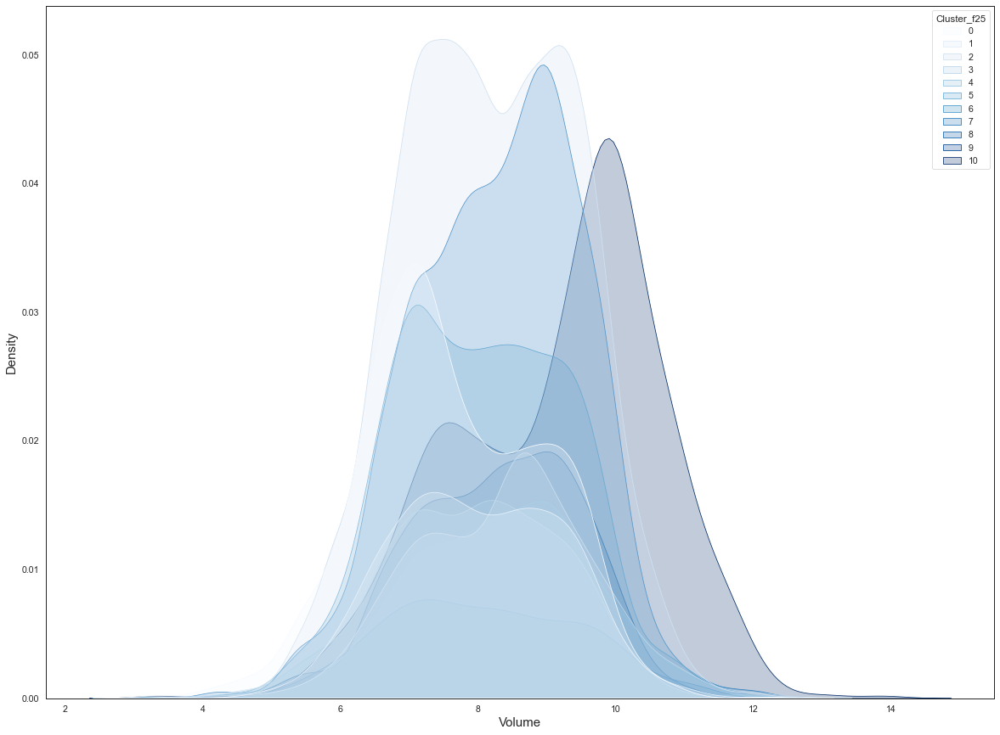

In [44]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the kdeplot and set the font

j= sns.kdeplot(data=tra_nonzero, x="volume", hue="Cluster_f25", palette=('Blues'), shade=True)
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Volume', fontsize = 15)
ax.set_ylabel('Density', fontsize = 15)

#plt.savefig('Volume_fuzzy.png', dmi=1200)

plt.show()

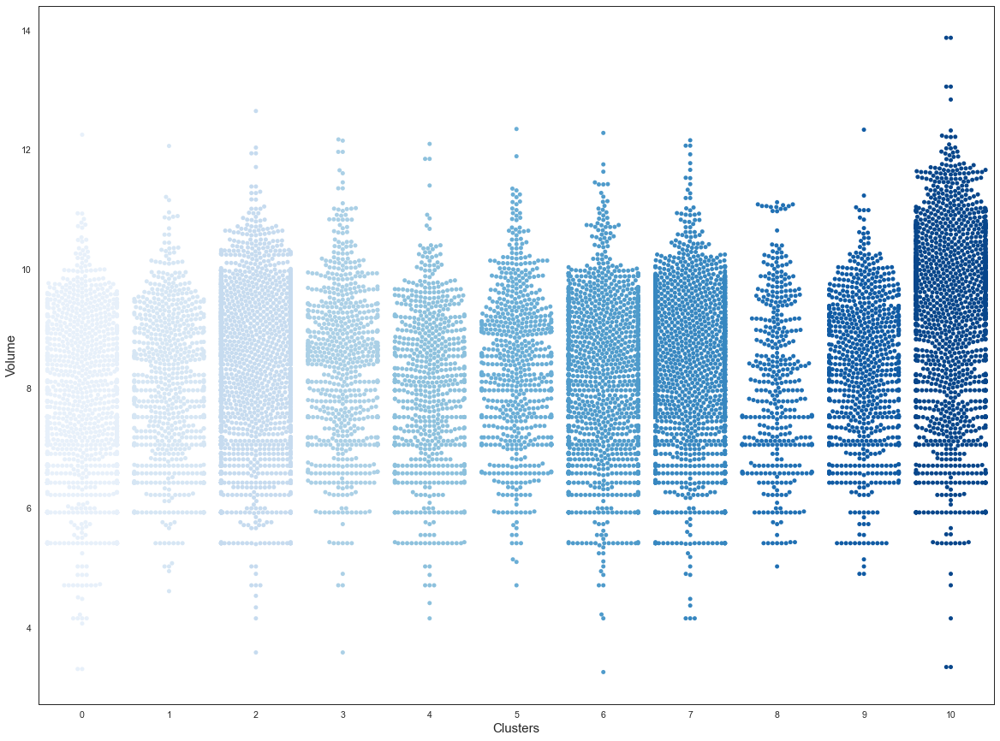

In [45]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_nonzero, x="Cluster_f25", y="volume",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Volume', fontsize = 15)

#plt.savefig('Volume_fuzzy2', dmi=1200)

plt.show()

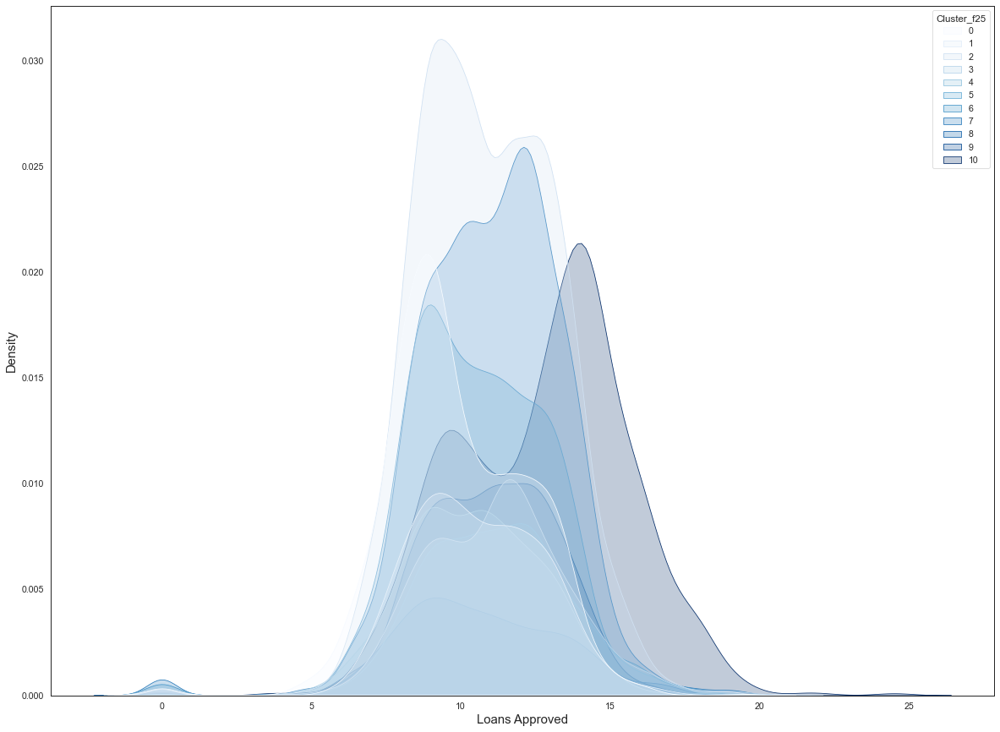

In [46]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the kdeplot and set the font

j= sns.kdeplot(data=tra_nonzero, x="loans_approved", hue="Cluster_f25", palette=('Blues'), shade=True)
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Loans Approved', fontsize = 15)
ax.set_ylabel('Density', fontsize = 15)

plt.show()

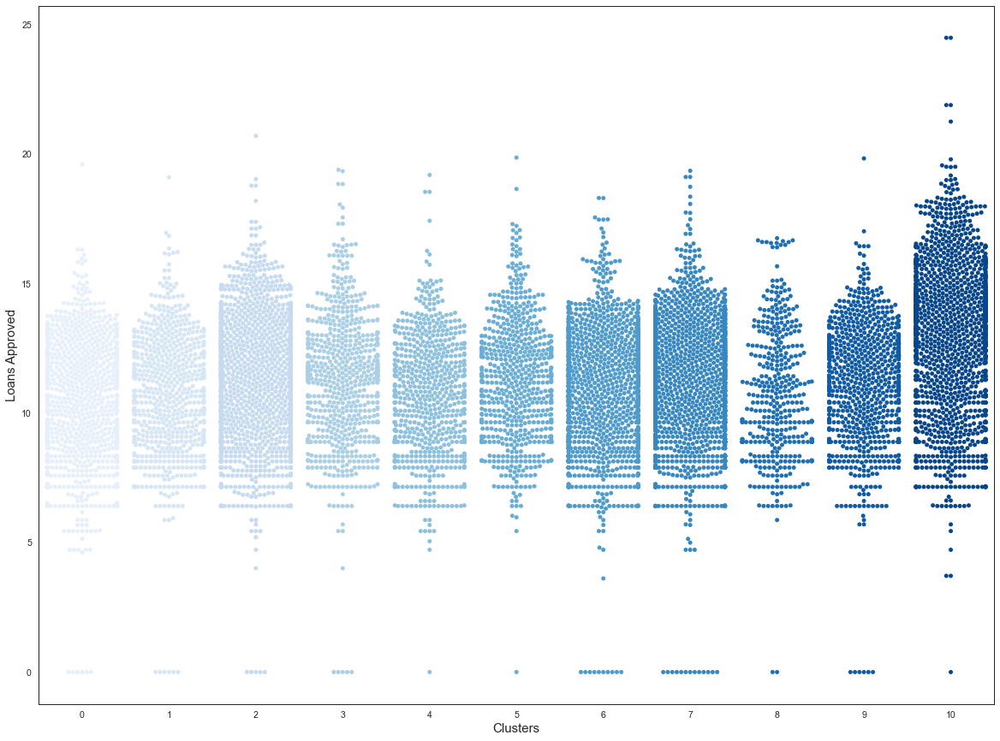

In [47]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_nonzero, x="Cluster_f25", y="loans_approved",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Loans Approved', fontsize = 15)

plt.show()

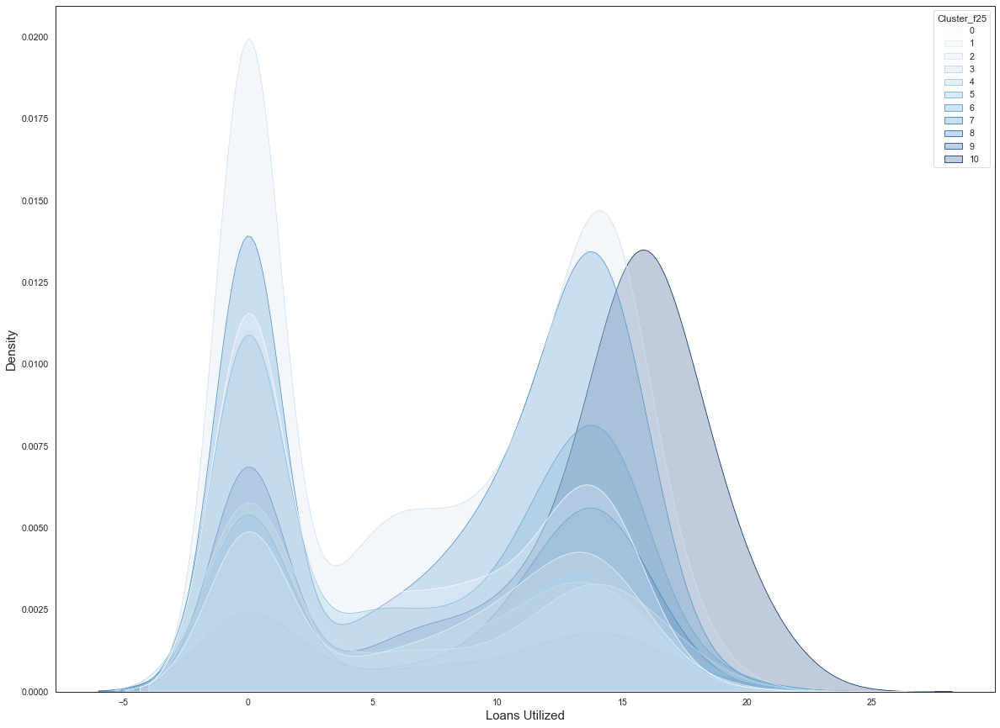

In [48]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the kdeplot and set the font

j= sns.kdeplot(data=tra_nonzero, x="loans_utilized", hue="Cluster_f25", palette=('Blues'), shade=True)
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Loans Utilized', fontsize = 15)
ax.set_ylabel('Density', fontsize = 15)

plt.show()

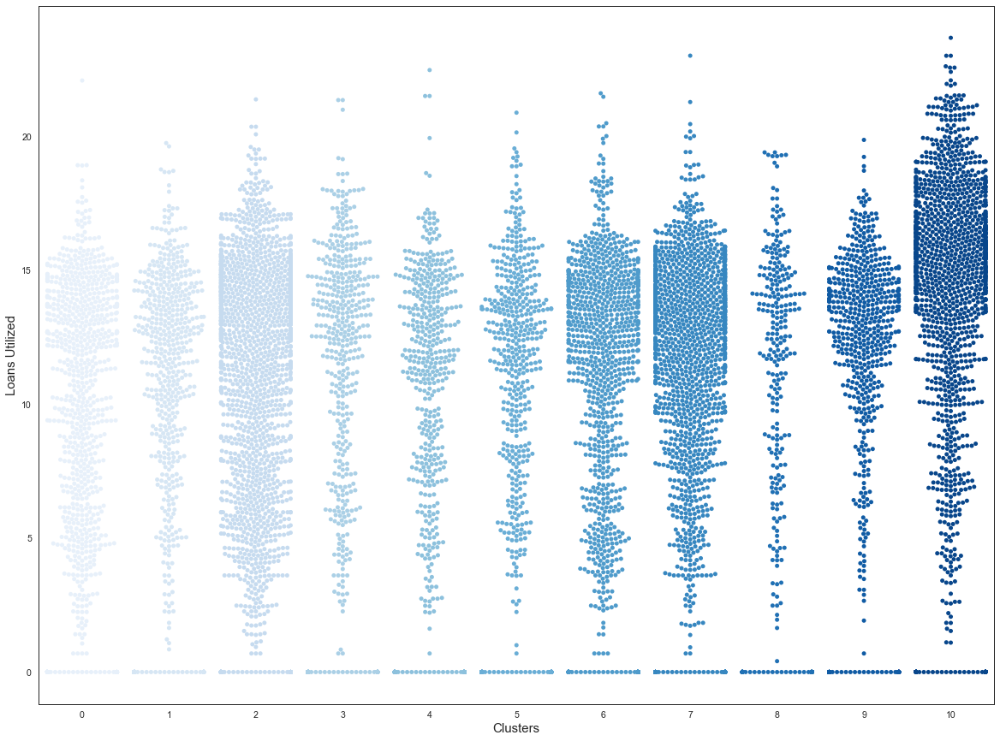

In [49]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_nonzero, x="Cluster_f25", y="loans_utilized",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Loans Utilized', fontsize = 15)

plt.show()

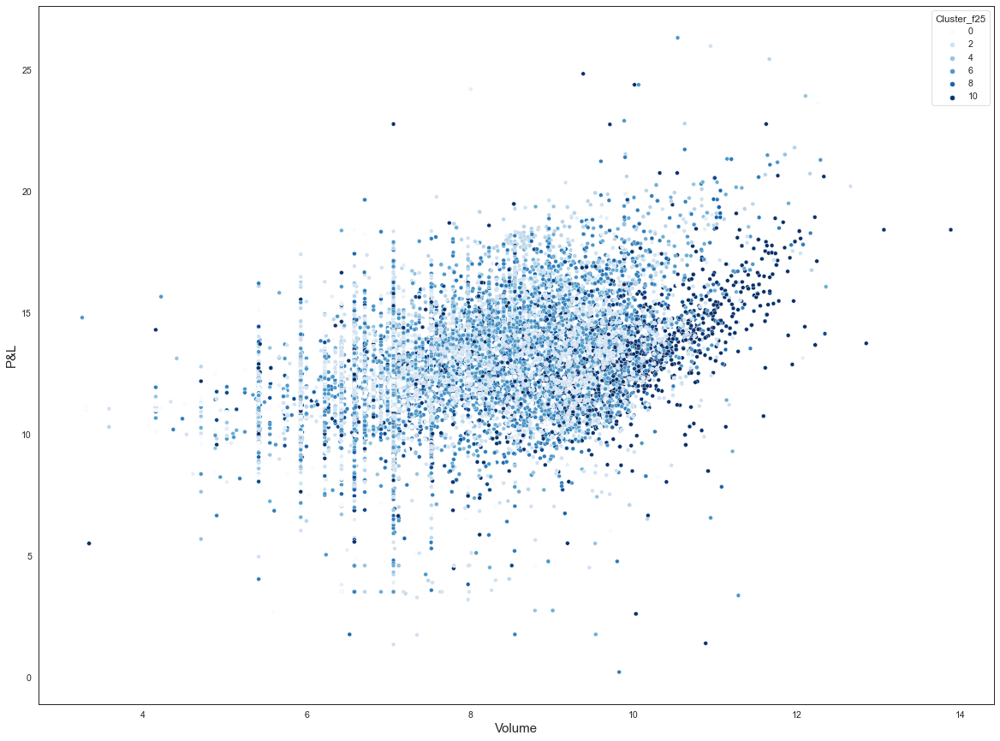

In [50]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the scatterplot and set the font

j= sns.scatterplot(data=tra_nonzero, x='volume', y='pl', hue='Cluster_f25', palette=('Blues'), ax=ax)
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Volume', fontsize = 15)
ax.set_ylabel('P&L', fontsize = 15)

plt.show()

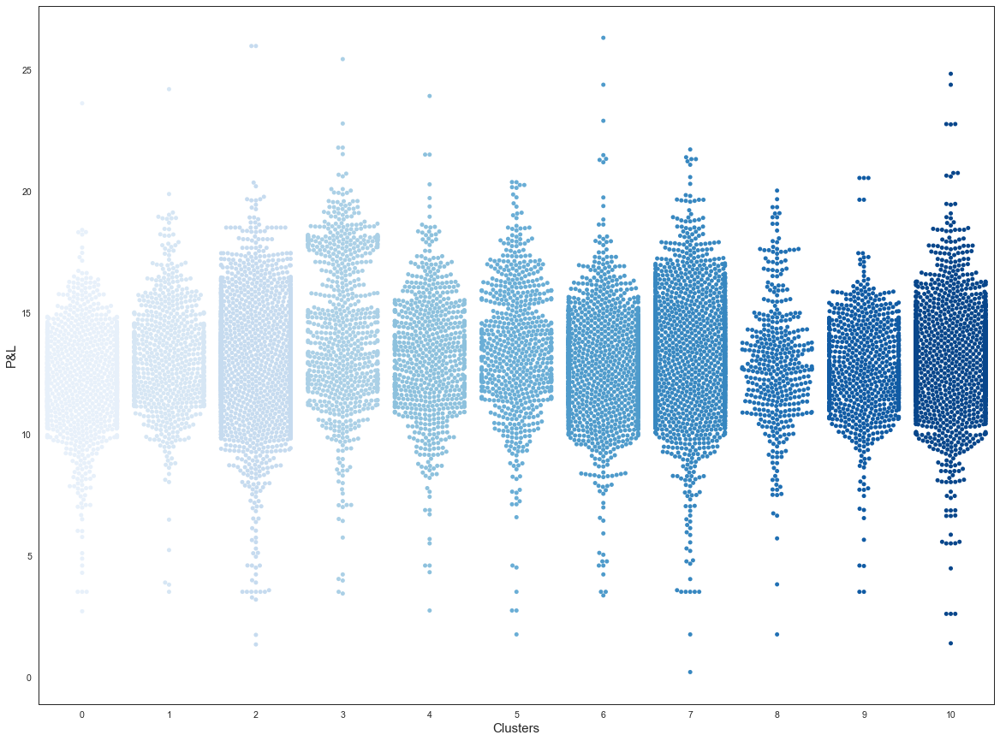

In [51]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_nonzero, x="Cluster_f25", y="pl",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('P&L', fontsize = 15)

#fig.savefig('cluster_f25.png', dpi=1200)

plt.show()

<Figure size 1440x1080 with 0 Axes>

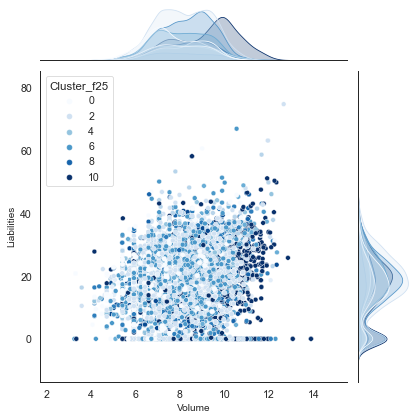

In [52]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

plt.figure(figsize=(20,15))

#create the jointplot and set the axis labels

j = sns.jointplot(data=tra_nonzero, x="volume", y="liabilities", hue="Cluster_f25", palette=('Blues'))
j.ax_joint.set_xlabel('Volume', fontsize = 10)
j.ax_joint.set_ylabel('Liabilities', fontsize = 10)

#plt.savefig('VolumeLiab_fuzzy.png', dmi=1200)

fig.savefig('cluster_f25.png', dpi=1200)

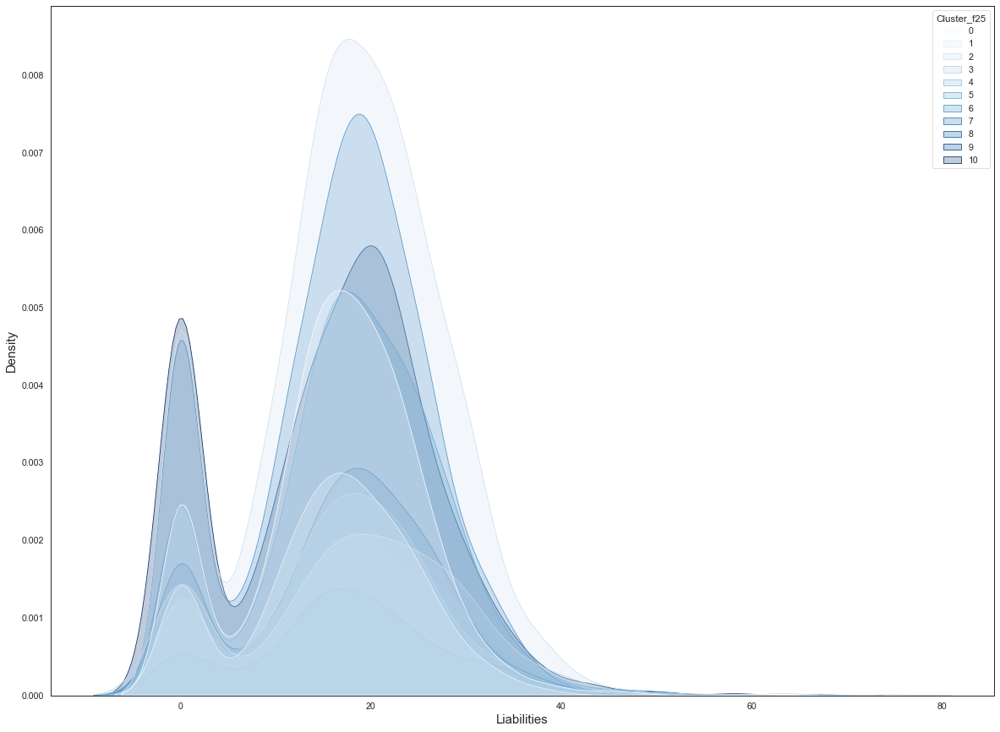

In [53]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the kdeplot and set the font

j= sns.kdeplot(data=tra_nonzero, x="liabilities", hue="Cluster_f25", palette=('Blues'), shade=True)
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Liabilities', fontsize = 15)
ax.set_ylabel('Density', fontsize = 15)

plt.show()

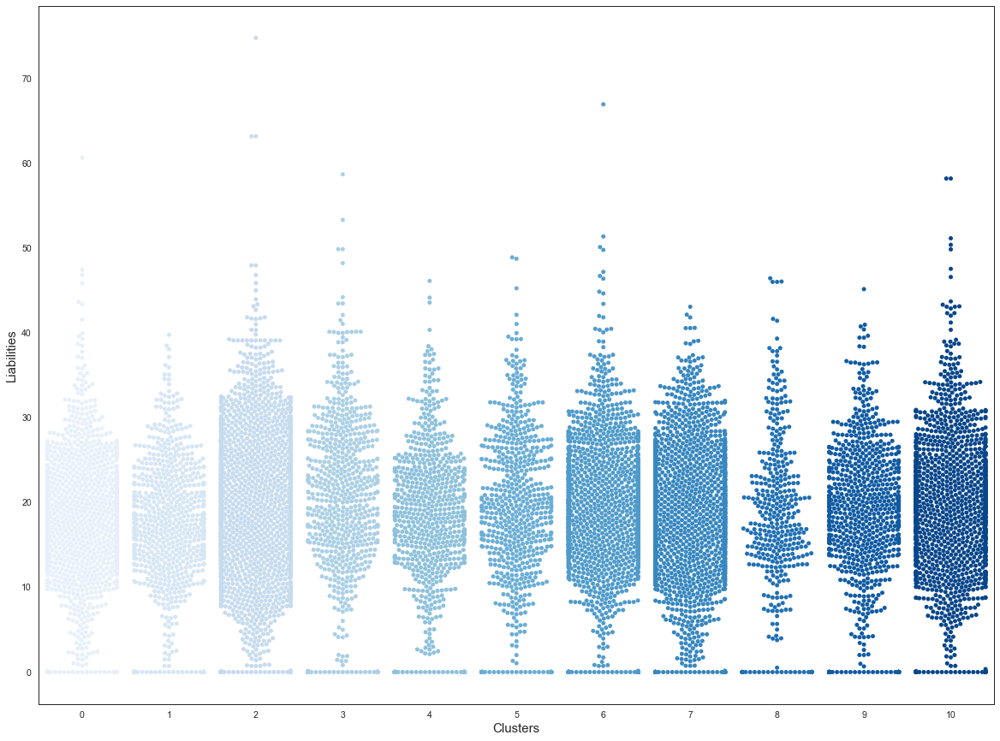

In [54]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_nonzero, x="Cluster_f25", y="liabilities",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Liabilities', fontsize = 15)

plt.show()

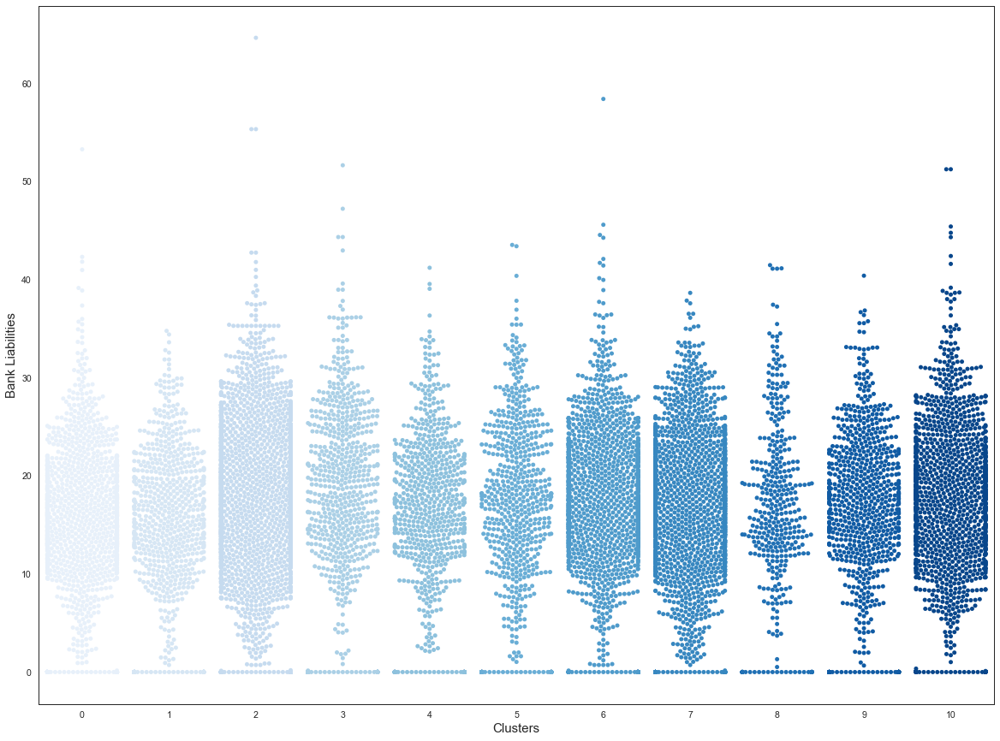

In [55]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_nonzero, x="Cluster_f25", y="bank_liabilities",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Bank Liabilities', fontsize = 15)

plt.show()

In [56]:
# # set the basic format (i.e. the palette for the color and the backgrounds)
# sns.set(rc={'axes.facecolor':'white'})
# sns.set_context("paper", font_scale = 1.2)
# sns.set_style("white")
# #sns.set_palette("BrBG_r")

# # set the size of the plot
# fig, ax = plt.subplots(figsize=(20,15))


# #create the swarmplot and set the font
# j= sns.swarmplot(data=tra_nonzero, x="Cluster_f25", y="other_liabilities",  palette=('Blues'))
# sns.set(font_scale = 1)

# # Set title, labels and ticks to each subplot
# ax.set_xlabel('Clusters', fontsize = 15)
# ax.set_ylabel('Other Liabilities', fontsize = 15)

# plt.show()

In [57]:
# # set the basic format (i.e. the palette for the color and the backgrounds)
# sns.set(rc={'axes.facecolor':'white'})
# sns.set_context("paper", font_scale = 1.2)
# sns.set_style("white")
# #sns.set_palette("BrBG_r")

# # set the size of the plot
# fig, ax = plt.subplots(figsize=(20,15))


# #create the swarmplot and set the font
# j= sns.swarmplot(data=tra_nonzero, x="Cluster_f25", y="new_commission_income",  palette=('Blues'))
# sns.set(font_scale = 1)

# # Set title, labels and ticks to each subplot
# ax.set_xlabel('Clusters', fontsize = 15)
# ax.set_ylabel('Commission Income', fontsize = 15)

# plt.show()

##### Distribution of Non-Financial Features <a class="anchor" id="13"></a>

Next we assess the non-financial features to complement the financial analysis and identify further intra-cluster differences

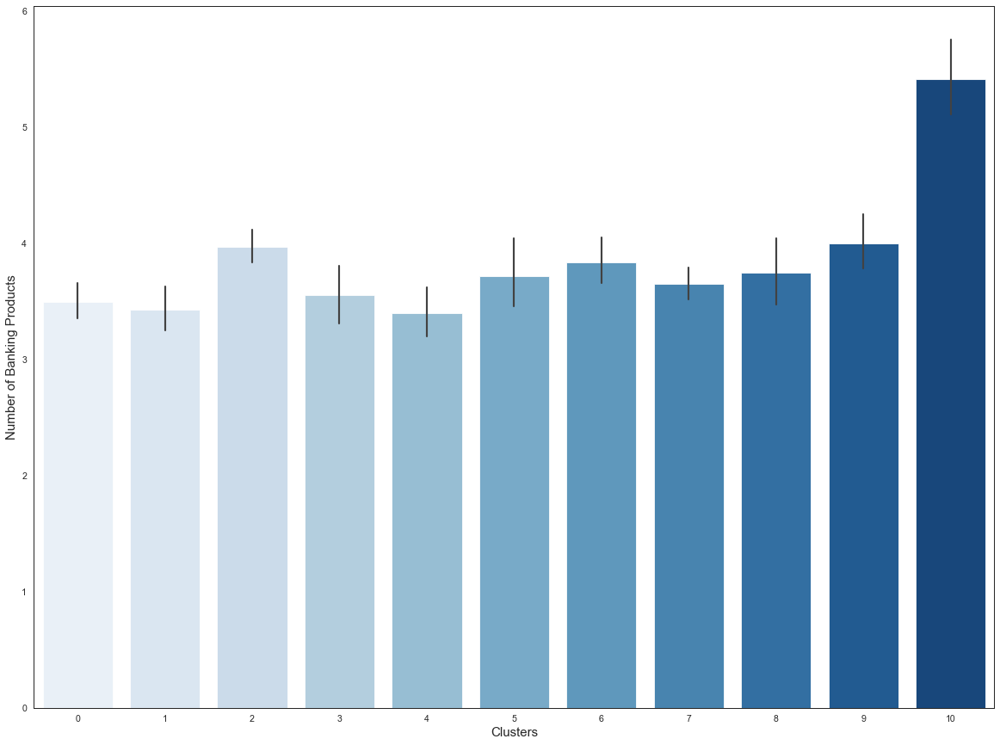

In [58]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the barplot and set the font

j= sns.barplot(x ='Cluster_f25', y ='banking_products', data = tra_nonzero, palette ='Blues')
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Number of Banking Products', fontsize = 15)

plt.show()

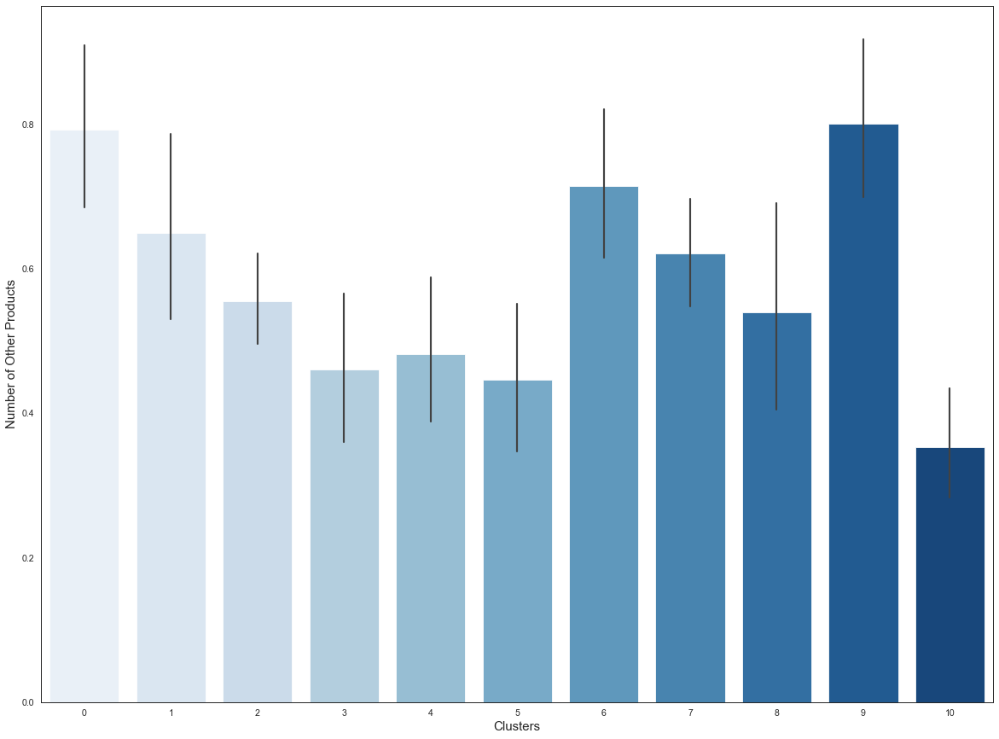

In [59]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the barplot and set the font

j= sns.barplot(x ='Cluster_f25', y ='other_products', data = tra_nonzero, palette ='Blues')
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Number of Other Products', fontsize = 15)

plt.show()

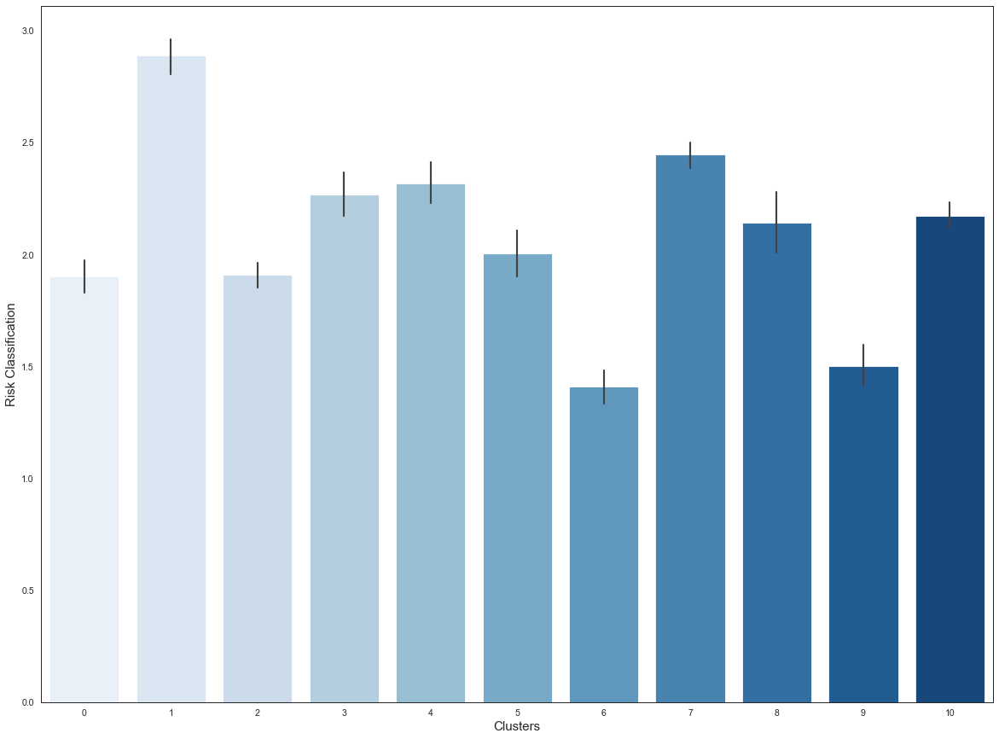

In [60]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the barplot and set the font

j= sns.barplot(x ='Cluster_f25', y ='risk', data = tra_nonzero, palette ='Blues')
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Risk Classification', fontsize = 15)

plt.show()

## Summary of Results

Both algorithms are capable of segmenting the clients quite efficiently while maintaing a high level of generalisability. As demonstrated by the averages of the clusters of the different models, K-Means does a superior job in diversifying the segments, however, this is also due to the lower number of observations contained within the dataset. When it comes to the financial features, K-Means is not fully capable of classiying clients based on the different levels of P&L. While it does recognize a few peaks in the distributions, most of the points are located in proximity. This entails that the algorithm should not be adopted for the classification of clients for the purpose of financial product developmnet. Nonetheless K-Means does an excellent job at identifying different product demands per cluster and different risk levels within the clusters. Fuzzy C-Means, on the other hand, is capable of doing a better job indiscerning amongst clients with different levels of volume, especially with loans approved. Specifically, it does recognise different distirbutions which is quite surprising. Nonetheless, the distirbutions are all still very close, entailing that Fuzzy C-Means should also not be used for product development. When observing the distribution of product demand and risk, Fuzzy C-Means does an exceptional job in recognizing inherent differences in the clusters, just like K-Means. This thus entails that the algorithms should be adopted for the purposes of marketing and customer experiences rather than financial processes. Specifically, by discerning between client product demands and risk levels, the alogorithms can design improved marketing campaings and customer journeys, improvinf the overall efficiency of the bank.

## UMAP Models <a class="anchor" id="14"></a>

Next we observe the models that were adopted on a UMAP reduced dataset, namely Agglomerative Clustering and FasterPAM.

Foremost we have to reduce the dimensions adopting a UMAP technique to vsualise the models. <br>

In [61]:
# we define the UMAP algorithm

um = UMAP.UMAP(n_neighbors=100, n_components=2, metric='euclidean', 
               n_epochs=1000, learning_rate=1.0, init='random', 
               min_dist=0.1, spread=1.0)

# Zero Dataset
# we apply UMAP to the zero dataset

U_zero = um.fit_transform(final_zero)

# Nonzero Dataset
# we apply UMAP to the zero dataset

U_nonzero = um.fit_transform(final_nonzero)

OMP: Info #271: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [62]:
# We select a UMAP with two components to visualise the clusters

umm_2d = UMAP.UMAP(n_components=2)

### Zero Dataset <a class="anchor" id="15"></a>

#### HAC

We concetnrate on the first model, HAC, which was applied on a zero dataset. This model provided greater data-specificity than the K-Means model, by selecting a higher number of clusters (i.e. 19). Depsite greater diversity within the segments, the model depicted extremely robust results.

In [63]:
# set the model and the respective parameters

hc_U_zero = AgglomerativeClustering(n_clusters = 19, affinity = 'euclidean', linkage ='average')

# Fit the function to the UMAP zero dataset

hc_U_zero.fit(U_zero)

# Assign the labels to the respective rows and further view the cluster segmentation 

final_zero['Cluster_h_U'] = hc_U_zero.labels_
tra_zero['Cluster_h_U'] = hc_U_zero.labels_

zero_df["Cluster_h_U"] = hc_U_zero.labels_
print('Distribution of Clusters: \n')
print(zero_df['Cluster_h_U'].value_counts())

Distribution of Clusters: 

2     1181
4      559
5      415
16     362
1      359
6      345
0      344
13     313
14     204
10     164
9      164
3      159
12     139
7      121
15     101
8       82
17      69
11      67
18      38
Name: Cluster_h_U, dtype: int64


In [64]:
print('The UMAP performance scores are the following: \n' )
print('Silhouette: ' + str(silhouette_score(U_zero, hc_U_zero.labels_ , metric='euclidean')))
print('Calinski Harabasz: ' + str(calinski_harabasz_score(U_zero, hc_U_zero.labels_ )))
print('Davies Bouldin: ' + str(davies_bouldin_score(U_zero, hc_U_zero.labels_)))

The UMAP performance scores are the following: 

Silhouette: 0.647735
Calinski Harabasz: 36694.58459178142
Davies Bouldin: 0.39719104173595265


The results in the original notebook are higher, this might be due to the application of UMAP. Nonetheles the results still portray good quality clusters. The next step is to visualise the clusters to determine their density.

#### Visualisation <a class="anchor" id="16"></a>

In [65]:
tt = tra_zero.drop(columns=['Cluster_h_U'])

U_2d = pd.DataFrame(umm_2d.fit_transform(tt))


# U1_2d: The first component by UMAP
# U2_2d: The second component by UMAP


U_2d.columns = ["U1_2d", "U2_2d"]


tra_zero1=tra_zero.copy()

tra_zero1 = pd.concat([tra_zero1, U_2d], axis=1, join='inner')

In [66]:
cluster = []
idd = []
for i in tra_zero1["Cluster_h_U"].value_counts().index:
    n = i
    id_ = 'cluster_' + str(n)
    m = str(id_) +  ' = ' + 'tra_zero1[tra_zero1["Cluster_h_U"] == ' + str(n) + ']'
    idd.append(id_)
    cluster.append(m)
    
for i in cluster:
    exec(i)

nn = []
l = []    
for i in idd:
    b = 'trace' + i 
    p = 'go.Scatter(x =' + i + '["U1_2d"], y =' + i + '["U2_2d"], mode = "markers", text = None)'
    l.append(b)
    nn.append(p)

commands = {}
for a,b in zip(nn,l):
    key=str(b)
    commands[key]=a
            
for key, value in commands.items():
    exec (f'{key}={value}')            

In [67]:
for i in l:
    print(i)

tracecluster_2
tracecluster_4
tracecluster_5
tracecluster_16
tracecluster_1
tracecluster_6
tracecluster_0
tracecluster_13
tracecluster_14
tracecluster_10
tracecluster_9
tracecluster_3
tracecluster_12
tracecluster_7
tracecluster_15
tracecluster_8
tracecluster_17
tracecluster_11
tracecluster_18


In [68]:
layout = dict(
              xaxis= dict(title= 'U1',ticklen= 5,zeroline= False),
              yaxis= dict(title= 'U2',ticklen= 5,zeroline= False)
             )

fig = go.Figure(dict(data = [tracecluster_2,
tracecluster_0,
tracecluster_1,
tracecluster_16,
tracecluster_4,
tracecluster_6,
tracecluster_7,
tracecluster_18,
tracecluster_5,
tracecluster_10,
tracecluster_11,
tracecluster_13,
tracecluster_3,
tracecluster_17,
tracecluster_8,
tracecluster_15,
tracecluster_14,
tracecluster_9,
tracecluster_12], layout = layout))

pyo.iplot(fig)

#fig.write_image("HAC.png", scale= 2)

While the colors do not make the graph easy to interpret, the clusters are still visible and apperently well separated within the two dimensional plot.

#### Customer Distribution  <a class="anchor" id="17"></a>

In [69]:
# # we select random clusters to check their averages

# random.sample(range(0, 18),7)

In [70]:
# we select important features to determine their resepctive averages

feat_3 = ['legal','volume_firm','loans_utilized','liabilities','bank_liabilities', 'pl',
          'banking_products', 'other_products','new_commission_income','new_cmib', 'year',
          'risk', 'postcode','size', 'Cluster_h_U']

# we group by cluster and portray the averages

desc_3 = zero_df[feat_3].groupby('Cluster_h_U', as_index = True).mean().T
desc_3[[7, 3, 10, 0, 1, 12, 11]]

Cluster_h_U,7,3,10,0,1,12,11
legal,1.218182e+01,15.408805,0.390244,1.946512e+01,1.883565e+01,9.784173e-01,41.402985
volume_firm,5.558371e+06,918563.663019,849145.715244,2.379143e+06,9.789944e+06,2.553846e+06,998637.242836
loans_utilized,4.390744e+00,16.318428,57.795244,4.066802e+00,2.430234e+01,5.537626e+00,16.759552
liabilities,5.956320e+04,43418.789182,43463.073659,1.289675e+05,4.608824e+04,1.969550e+04,57731.986119
bank_liabilities,5.956320e+04,41530.888176,31435.757378,1.232929e+05,4.608824e+04,1.969550e+04,57360.063134
pl,3.276817e+05,172543.345987,139012.438585,3.670704e+05,4.745772e+05,1.839122e+05,255404.138388
banking_products,4.933884e+00,1.540881,1.939024,1.683140e+00,1.069638e+00,5.575540e+00,2.835821
other_products,0.000000e+00,0.169811,0.548780,3.866279e-01,0.000000e+00,0.000000e+00,0.044776
new_commission_income,1.838135e+02,53.857799,198.157866,1.822814e+02,2.123505e+02,7.152309e+01,51.921343
new_cmib,4.614292e+02,339.056667,1478.670244,4.114646e+02,5.073462e+02,1.504806e+02,366.190299


The averages seem well distributed, with different clusters having dissimiliar ranges. The first noticeable characteristic is that HAC introduces more central customers. While K-Means and Fuzzy C-MEans primarily displayed clusters with extreme values on either side of the spectrum, HAC does a better jon indiverifying cetnral clients too.

##### Distribution of Financial Features   <a class="anchor" id="18"></a>

Now we check the distribution of financial features to determine how important financial characteristics are in the segmentations.

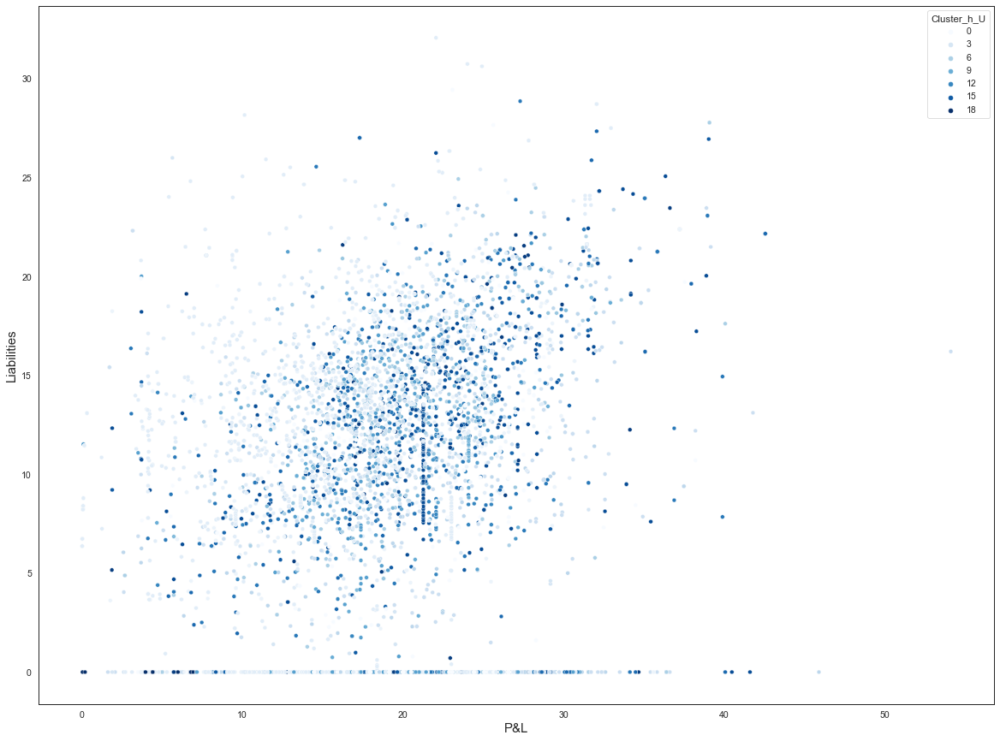

In [71]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the scatterplot and set the font

j= sns.scatterplot(data=tra_zero, x='pl', y='liabilities', hue='Cluster_h_U', palette=('Blues'), ax=ax)
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('P&L', fontsize = 15)
ax.set_ylabel('Liabilities', fontsize = 15)

plt.show()

Text(27.075000000000003, 0.5, 'P&L')

<Figure size 1440x1080 with 0 Axes>

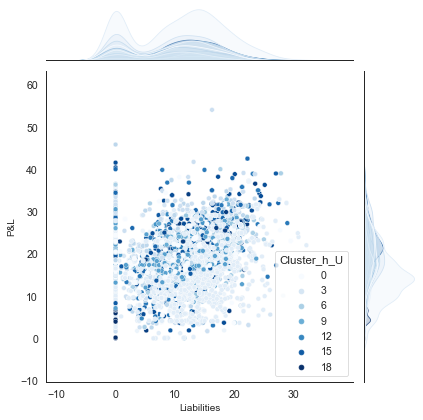

In [72]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

plt.figure(figsize=(20,15))

# we define the jointplot and set respective labels

j = sns.jointplot(data=tra_zero, x="liabilities", y="pl", hue="Cluster_h_U", palette=('Blues'))
j.ax_joint.set_xlabel('Liabilities', fontsize = 10)
j.ax_joint.set_ylabel('P&L', fontsize = 10)

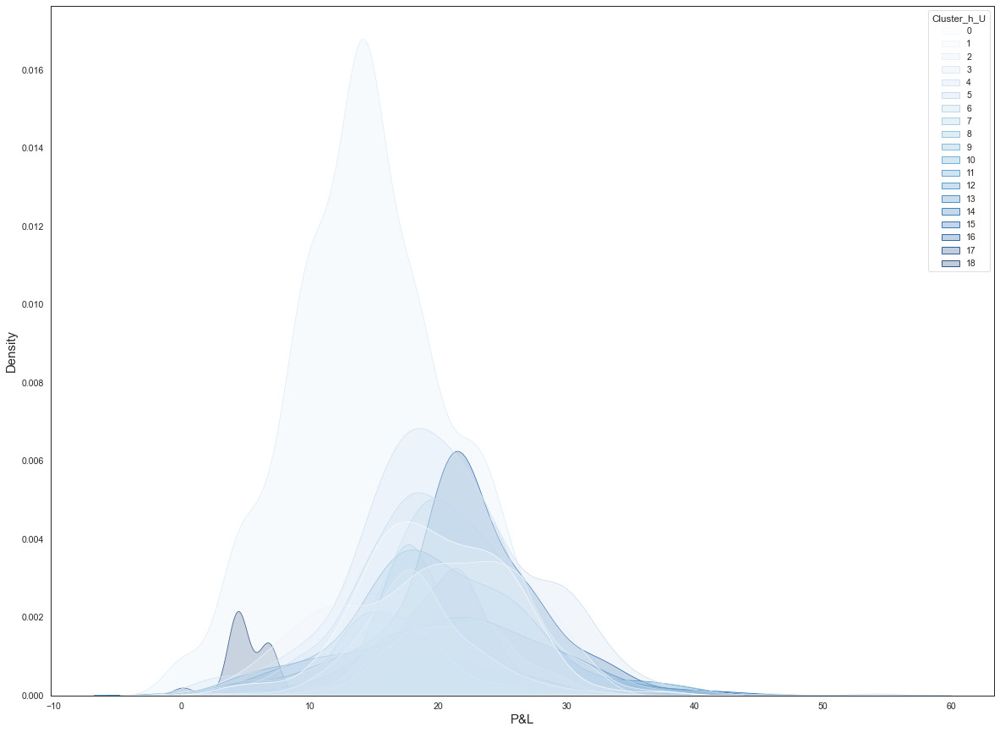

In [73]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the kdeplot and set the font

j= sns.kdeplot(data=tra_zero, x="pl", hue="Cluster_h_U", palette=('Blues'), shade=True)
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('P&L', fontsize = 15)
ax.set_ylabel('Density', fontsize = 15)

#plt.savefig('PL_hac.png', dmi=1200)


plt.show()

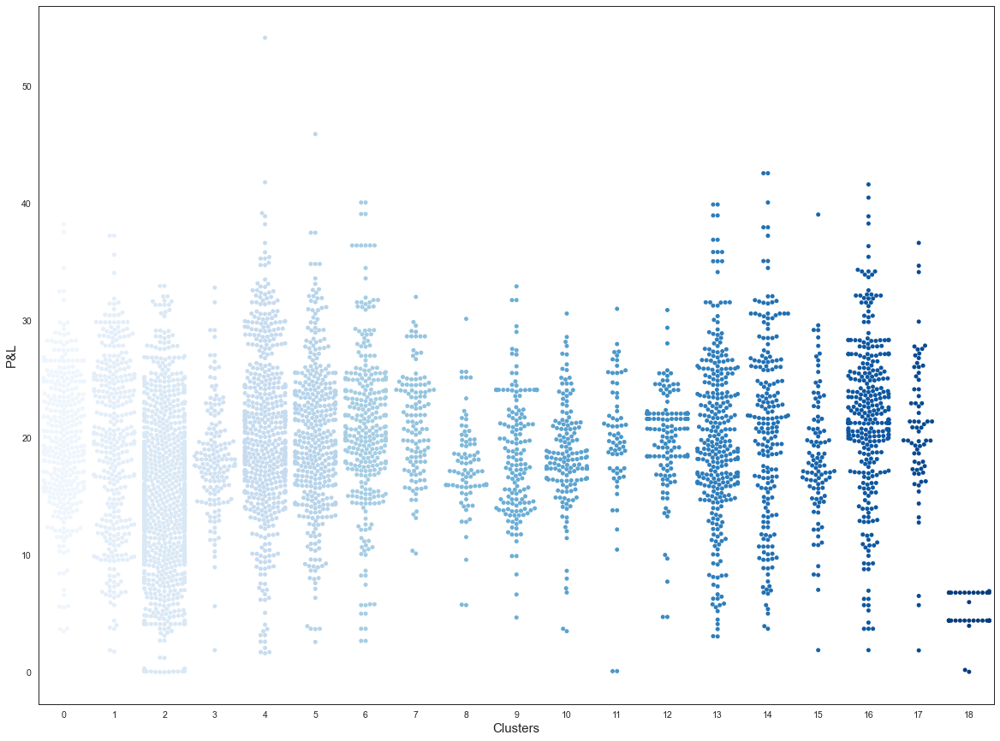

In [74]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_zero, x="Cluster_h_U", y="pl",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('P&L', fontsize = 15)

#plt.savefig('PL2_hac.png', dmi=1200)


plt.show()

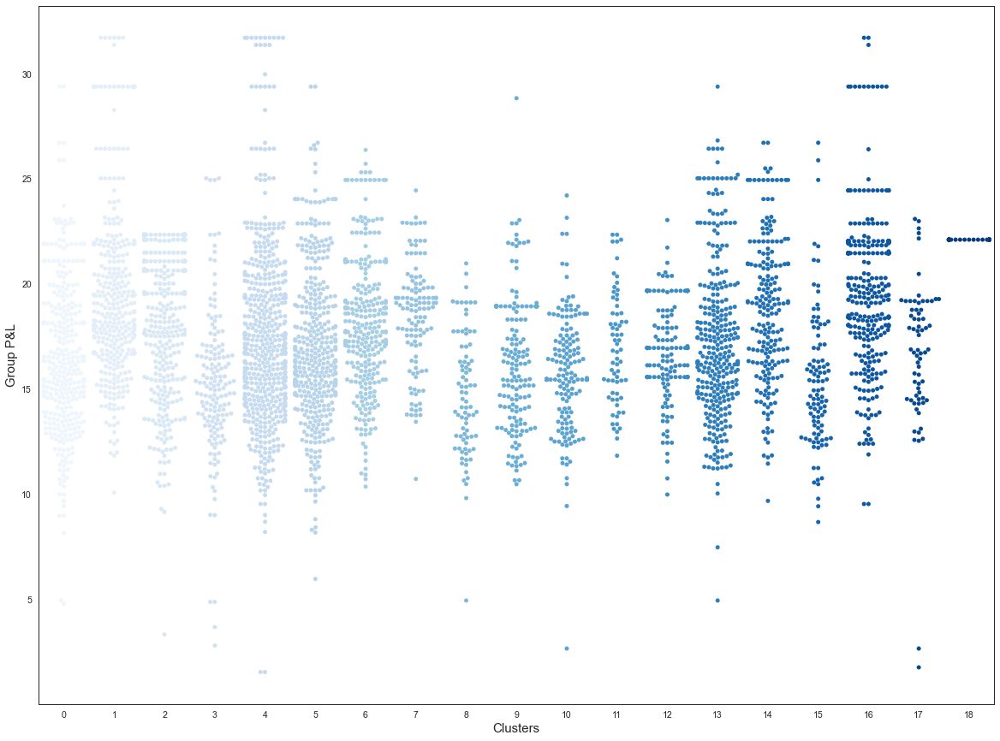

In [75]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_zero, x="Cluster_h_U", y="pl_firm",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Group P&L', fontsize = 15)

plt.show()

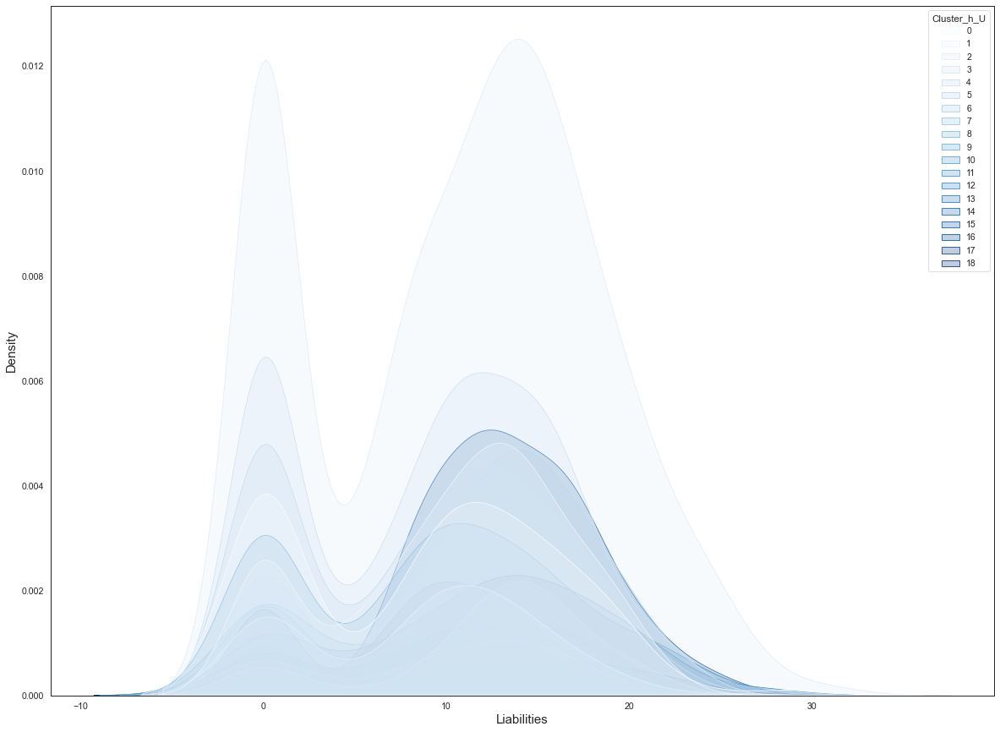

In [76]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the kdeplot and set the font

j= sns.kdeplot(data=tra_zero, x="liabilities", hue="Cluster_h_U", palette=('Blues'), shade=True)
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Liabilities', fontsize = 15)
ax.set_ylabel('Density', fontsize = 15)

plt.show()

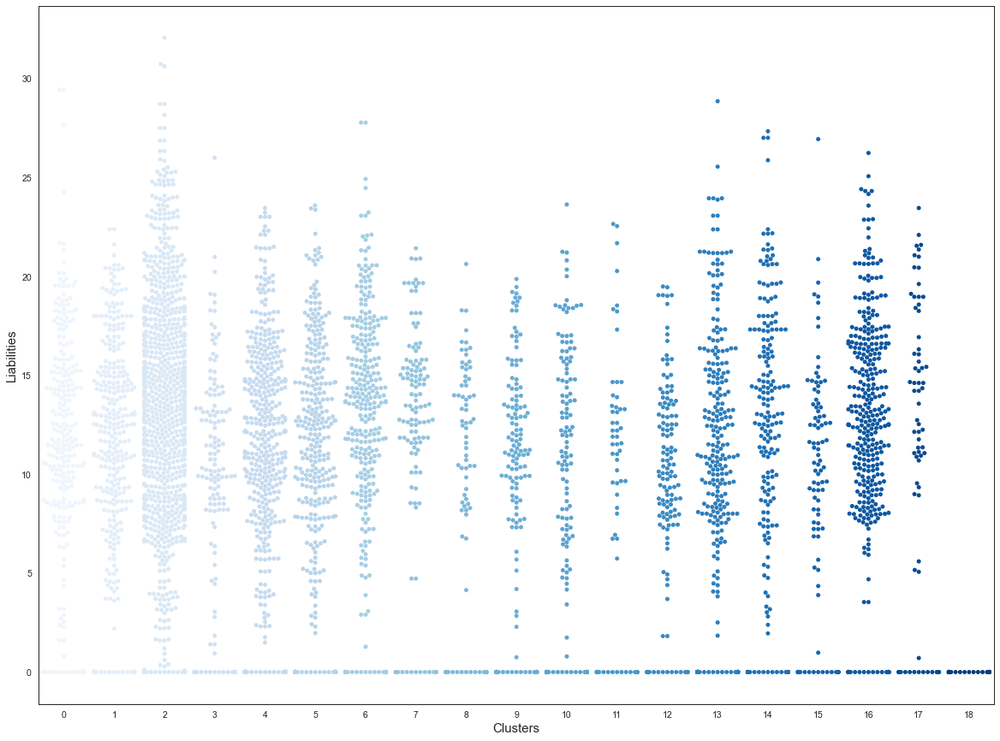

In [77]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_zero, x="Cluster_h_U", y="liabilities",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Liabilities', fontsize = 15)

plt.show()

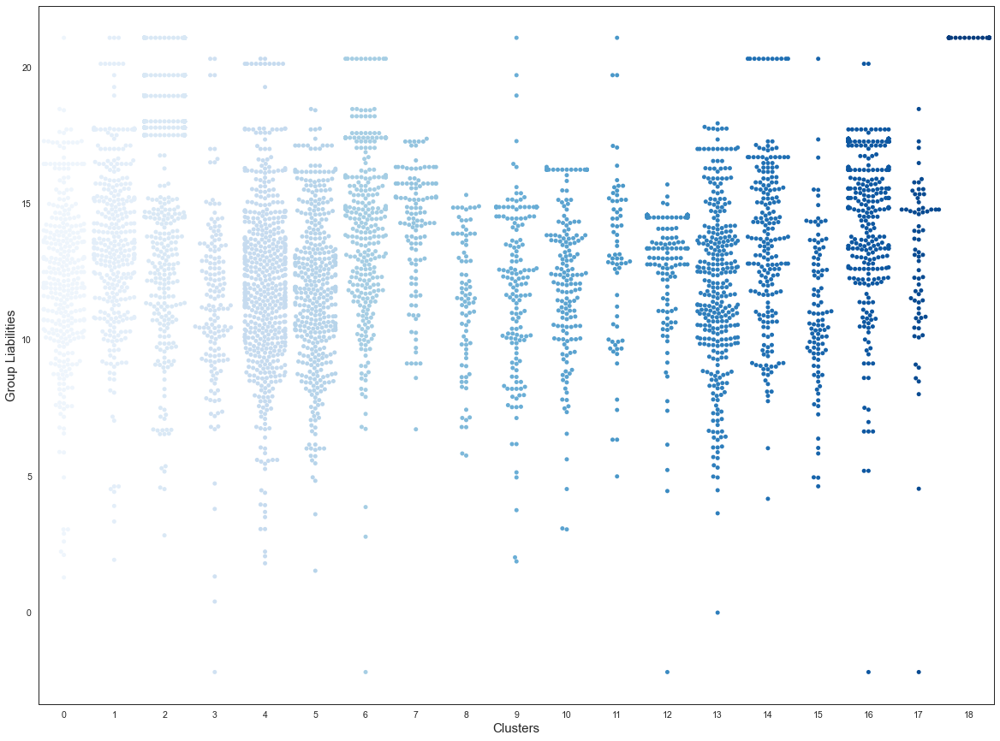

In [78]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_zero, x="Cluster_h_U", y="liabilities_firm",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Group Liabilities', fontsize = 15)

plt.show()

#### Distribution of Non-Financial Features    <a class="anchor" id="19"></a>

The history saving thread hit an unexpected error (OperationalError('database or disk is full')).History will not be written to the database.


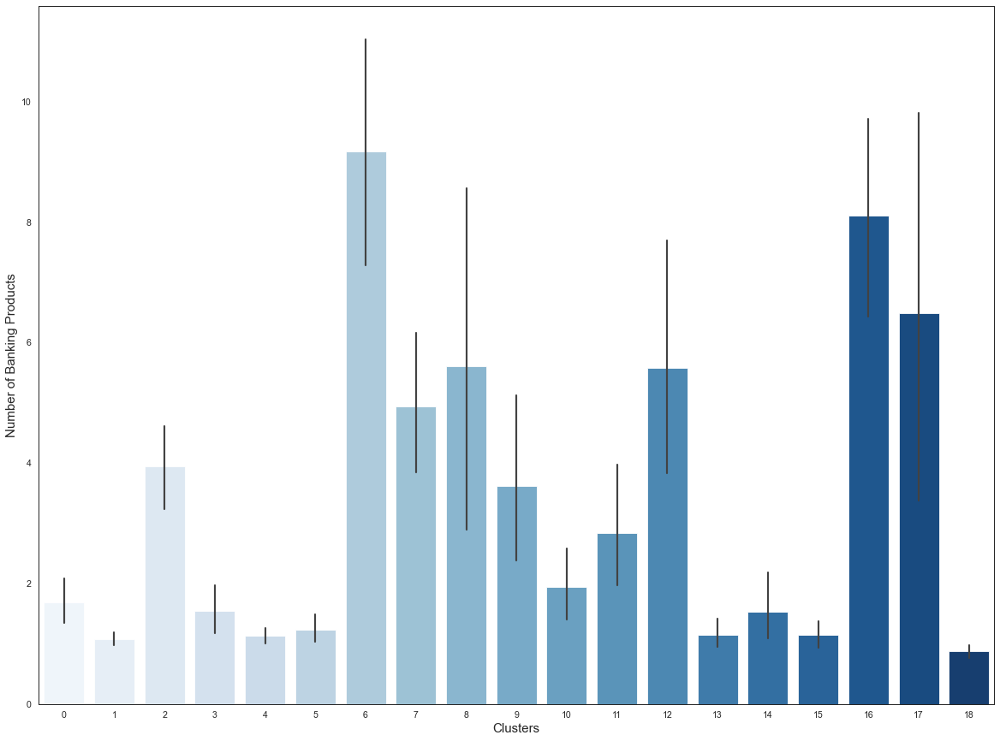

In [79]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the barplot and set the font

j= sns.barplot(x ='Cluster_h_U', y ='banking_products', data = tra_zero, palette ='Blues')
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Number of Banking Products', fontsize = 15)

plt.show()



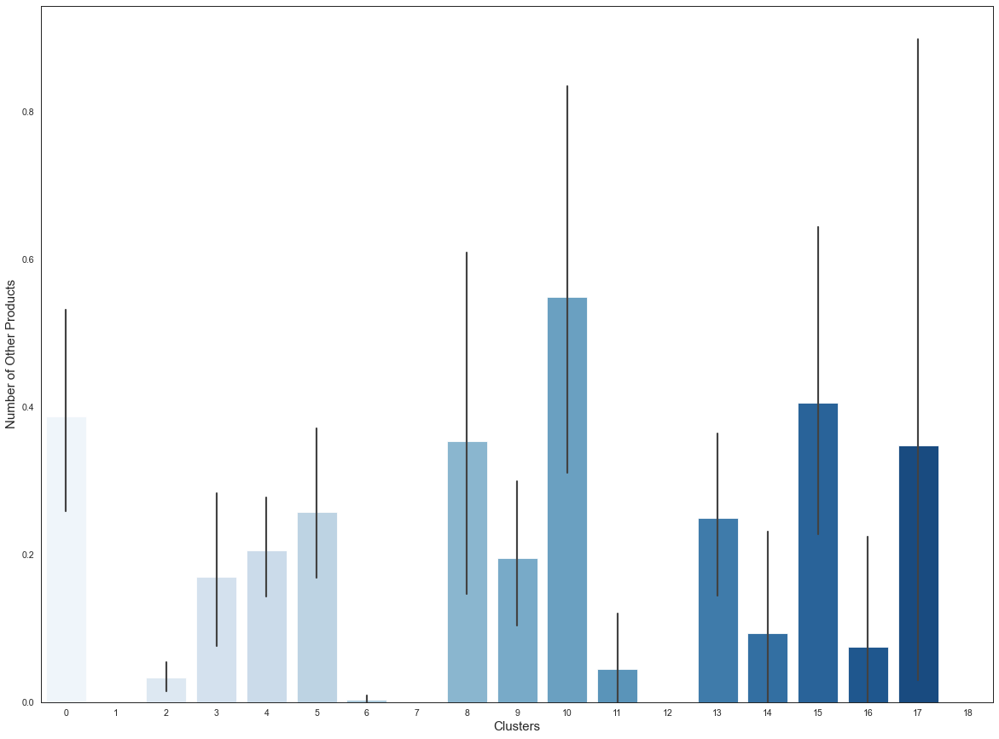

In [80]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the barplot and set the font

j= sns.barplot(x ='Cluster_h_U', y ='other_products', data = tra_zero, palette ='Blues')
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Number of Other Products', fontsize = 15)

plt.show()

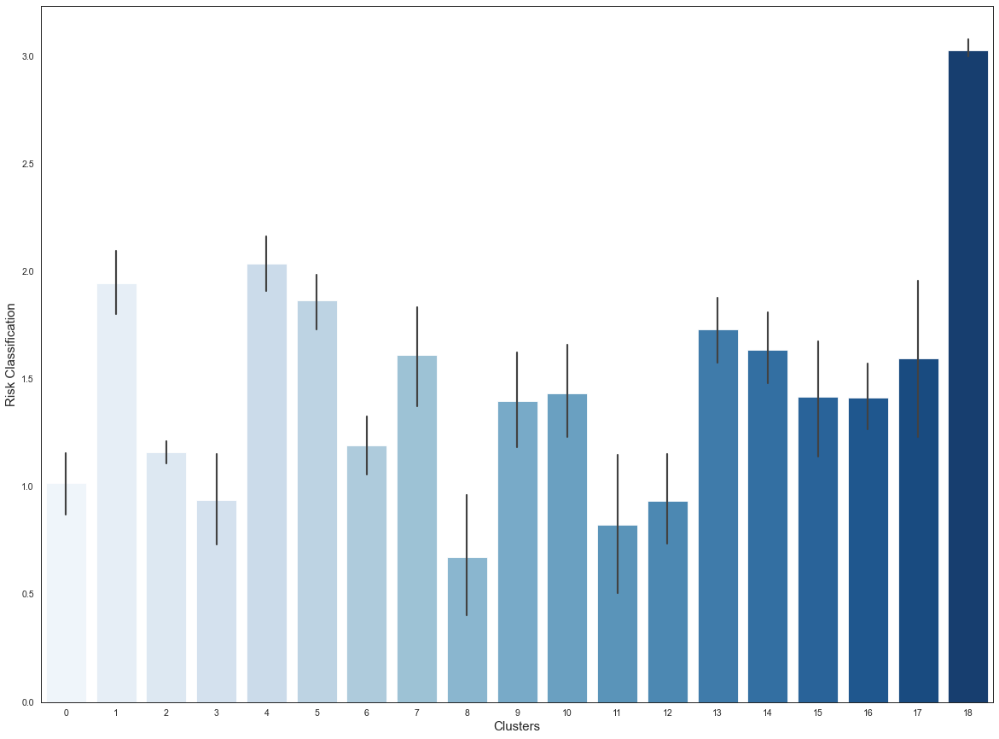

In [81]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the barplot and set the font

j= sns.barplot(x ='Cluster_h_U', y ='risk', data = tra_zero, palette ='Blues')
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Risk Classification', fontsize = 15)

plt.show()

### Nonzero Dataset  <a class="anchor" id="19"></a>

Lastly we consider the FasterPAM algorithm. The aformentioned was extremely robust in diversifying amongst clients, allowing to create 40 clusters. This high level of specificity was achieved while maintaining very strong scores for Silhouette, Calinski Harabasz and Davies Bouldin.

#### FasterPAM

In order to plot the features we must first fit the algorithm to the dataset.

In [82]:
# develop a dissimilarity matrix using minkowski for fasterpam 

mat_n = pairwise_distances(U_nonzero, metric='minkowski')

In [83]:
# we define the function for K-Modes

fast_nonzero_U = fasterpam(mat_n, medoids = 40, max_iter = 2000, init ='random', random_state = 9)


# Assign the labels to the respective rows and further view the cluster segmentation 

final_nonzero['Cluster_fast_U'] = fast_nonzero_U.labels

tra_nonzero['Cluster_fast_U'] = fast_nonzero_U.labels

nonzero_df["Cluster_fast_U"] = fast_nonzero_U.labels

print('Distribution of Clusters: \n')
print(nonzero_df['Cluster_fast_U'].value_counts())

Distribution of Clusters: 

31    976
38    738
21    676
7     653
14    614
5     588
18    543
33    523
24    468
16    447
3     441
1     423
28    398
0     398
17    389
6     384
2     382
11    356
26    326
10    278
29    271
34    262
39    259
37    247
30    241
36    230
27    230
20    216
22    215
32    212
25    188
23    153
19    151
15    150
12    145
8     143
4     128
13    127
35    124
9     114
Name: Cluster_fast_U, dtype: int64


In [84]:
print('The UMAP performance scores are the following: \n' )
print('Silhouette: ' + str(silhouette_score(U_nonzero, fast_nonzero_U.labels , metric='euclidean')))
print('Calinski Harabasz: ' + str(calinski_harabasz_score(U_nonzero, fast_nonzero_U.labels)))
print('Davies Bouldin: ' + str(davies_bouldin_score(U_nonzero, fast_nonzero_U.labels)))

The UMAP performance scores are the following: 

Silhouette: 0.7708836
Calinski Harabasz: 112951.70330254664
Davies Bouldin: 0.3004378482629123


#### Visualisation  <a class="anchor" id="21"></a>

Next we depict the clusters in a two dimensional plot in order to see their distributions.

In [85]:
tt = tra_nonzero.drop(columns=['Cluster_fast_U'])

U_2d = pd.DataFrame(umm_2d.fit_transform(tt))


# U1_2d: The first component by UMAP
# U2_2d: The second component by UMAP


U_2d.columns = ["U1_2d", "U2_2d"]


tra_nonzero1=tra_nonzero.copy()

tra_nonzero1 = pd.concat([tra_nonzero1, U_2d], axis=1, join='inner')

In [86]:
cluster = []
idd = []
for i in tra_nonzero1["Cluster_fast_U"].value_counts().index:
    n = i
    id_ = 'cluster_' + str(n)
    m = str(id_) +  ' = ' + 'tra_nonzero1[tra_nonzero1["Cluster_fast_U"] == ' + str(n) + ']'
    idd.append(id_)
    cluster.append(m)
    
for i in cluster:
    exec(i)

nn = []
l = []    
for i in idd:
    b = 'trace' + i 
    p = 'go.Scatter(x =' + i + '["U1_2d"], y =' + i + '["U2_2d"], mode = "markers", text = None)'
    l.append(b)
    nn.append(p)

commands = {}
for a,b in zip(nn,l):
    key=str(b)
    commands[key]=a
            
for key, value in commands.items():
    exec (f'{key}={value}') 

In [87]:
for i in l:
    print(i)

tracecluster_31
tracecluster_38
tracecluster_21
tracecluster_7
tracecluster_14
tracecluster_5
tracecluster_18
tracecluster_33
tracecluster_24
tracecluster_16
tracecluster_3
tracecluster_1
tracecluster_28
tracecluster_0
tracecluster_17
tracecluster_6
tracecluster_2
tracecluster_11
tracecluster_26
tracecluster_10
tracecluster_29
tracecluster_34
tracecluster_39
tracecluster_37
tracecluster_30
tracecluster_36
tracecluster_27
tracecluster_20
tracecluster_22
tracecluster_32
tracecluster_25
tracecluster_23
tracecluster_19
tracecluster_15
tracecluster_12
tracecluster_8
tracecluster_4
tracecluster_13
tracecluster_35
tracecluster_9


In [88]:
layout = dict(
              xaxis= dict(title= 'U1',ticklen= 5,zeroline= False),
              yaxis= dict(title= 'U2',ticklen= 5,zeroline= False)
             )

fig = go.Figure(dict(data = [tracecluster_24,
tracecluster_30,
tracecluster_33,
tracecluster_14,
tracecluster_5,
tracecluster_18,
tracecluster_7,
tracecluster_31,
tracecluster_2,
tracecluster_3,
tracecluster_19,
tracecluster_28,
tracecluster_38,
tracecluster_22,
tracecluster_17,
tracecluster_29,
tracecluster_6,
tracecluster_1,
tracecluster_36,
tracecluster_4,
tracecluster_0,
tracecluster_13,
tracecluster_23,
tracecluster_39,
tracecluster_10,
tracecluster_34,
tracecluster_32,
tracecluster_27,
tracecluster_35,
tracecluster_37,
tracecluster_20,
tracecluster_11,
tracecluster_25,
tracecluster_15,
tracecluster_21,
tracecluster_12,
tracecluster_8,
tracecluster_26,
tracecluster_16,
tracecluster_9], layout = layout))

pyo.iplot(fig)

#fig.write_image("Kmeadoids.png", scale= 2)

It can be seen that UMAP does an incredibly good job in reducing the dimensions of the dataset. Specifically it diversifies between 6 major groups and uses those to create further segmentations. Once again the color spectrum is too limited to provide an optimal visualisation but the clusters appear clearly diversifies and well densely populated. 

#### Customer Distribution  <a class="anchor" id="22"></a>

In [89]:
# # we select random clusters to depict cluster averages

# random.sample(range(0, 40),7)

In [90]:
# we select the most important features

feat_4 = ['legal','volume','loans_utilized', 'liabilities','bank_liabilities', 'pl', 'banking_products', 
          'other_products', 'new_commission_income','new_cmib', 'year', 'risk', 'postcode','size', 'Cluster_fast_U']

# we group by cluster and portray the averages

desc_4 = nonzero_df[feat_4].groupby('Cluster_fast_U', as_index = True).mean().T
desc_4[[33, 8, 22, 26, 6, 34, 30]]

Cluster_fast_U,33,8,22,26,6,34,30
legal,0.254302,8.741259e-01,1.929302e+01,3.225460e+01,2.160417e+01,1.098092e+01,3.934855e+01
volume,91419.948776,2.104281e+05,1.326735e+06,4.883571e+05,4.404286e+05,1.255014e+06,3.123375e+07
loans_utilized,75049.094417,1.868056e+05,4.037521e+05,2.399922e+05,3.209884e+05,1.110576e+06,2.563271e+05
liabilities,75207.306463,2.878681e+04,4.650385e+05,9.809308e+04,1.173455e+05,3.329766e+04,4.474152e+04
bank_liabilities,65461.625946,2.792682e+04,4.650385e+05,9.428789e+04,1.165168e+05,3.211154e+04,3.874006e+04
pl,289431.432948,8.119606e+06,2.430616e+07,1.602506e+06,4.886737e+06,3.469470e+05,4.515196e+06
banking_products,3.541109,4.279720e+00,3.311628e+00,3.432515e+00,3.140625e+00,4.564885e+00,4.659751e+00
other_products,0.988528,5.104895e-01,0.000000e+00,6.165644e-01,1.171875e-01,6.488550e-02,9.211618e-01
new_commission_income,317.055201,2.379678e+02,1.706567e+03,3.803208e+02,1.503351e+03,3.242452e+02,1.645344e+02
new_cmib,2421.896042,1.822201e+03,6.993715e+03,1.366385e+03,1.045734e+04,3.903237e+03,6.456374e+02


The averages in this case are more specific than those of the HAC method. Specifically, the clusters are well defined and 'central' groups are clearly visible. This indicates that the algorithm does an exceptional job in diversifying the clients of the bank. This segmentation is highly valuable because such clear differences in mean can be adopted within many processes of a bank.

##### Distribution of Financial Features <a class="anchor" id="23"></a>

Next we check the distribution of the financial features, once again volume is quite an important feature in a banking context, as a result the algorithm shall do a good job in separating clients with different credit needs.

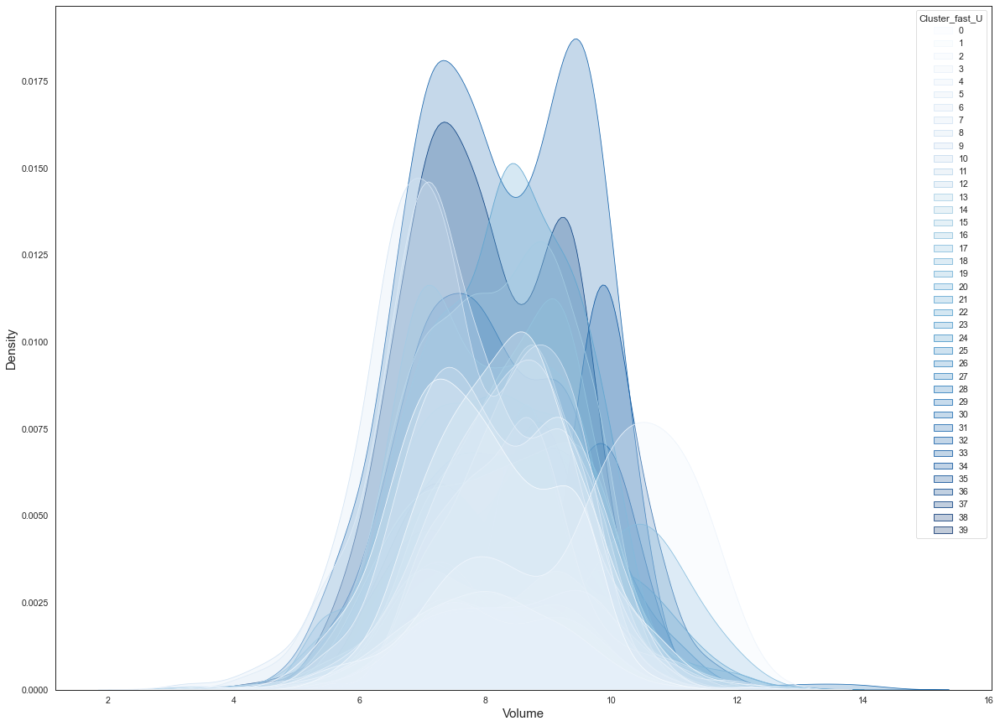

In [91]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the kdeplot and set the font

j= sns.kdeplot(data=tra_nonzero, x="volume", hue="Cluster_fast_U", palette=('Blues'), shade=True)
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Volume', fontsize = 15)
ax.set_ylabel('Density', fontsize = 15)

#plt.savefig('Volume_fast.png', dmi=1200)

plt.show()

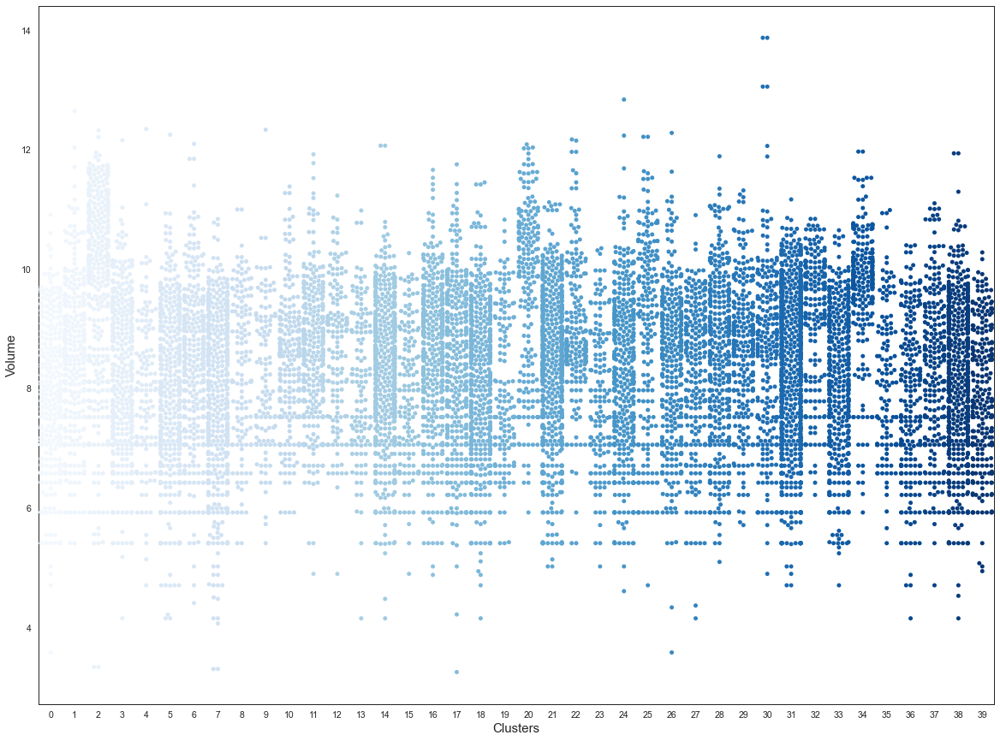

In [92]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_nonzero, x="Cluster_fast_U", y="volume",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Volume', fontsize = 15)

#plt.savefig('Volume2_fast.png', dmi=1200)

plt.show()

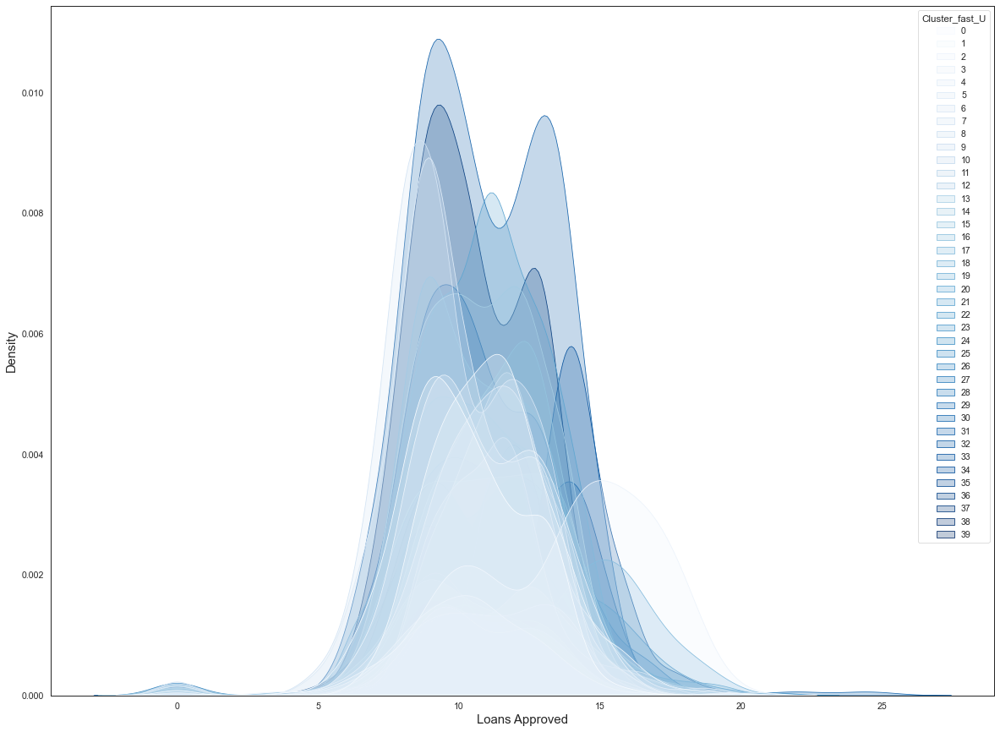

In [93]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the kdeplot and set the font

j= sns.kdeplot(data=tra_nonzero, x="loans_approved", hue="Cluster_fast_U", palette=('Blues'), shade=True)
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Loans Approved', fontsize = 15)
ax.set_ylabel('Density', fontsize = 15)

plt.show()

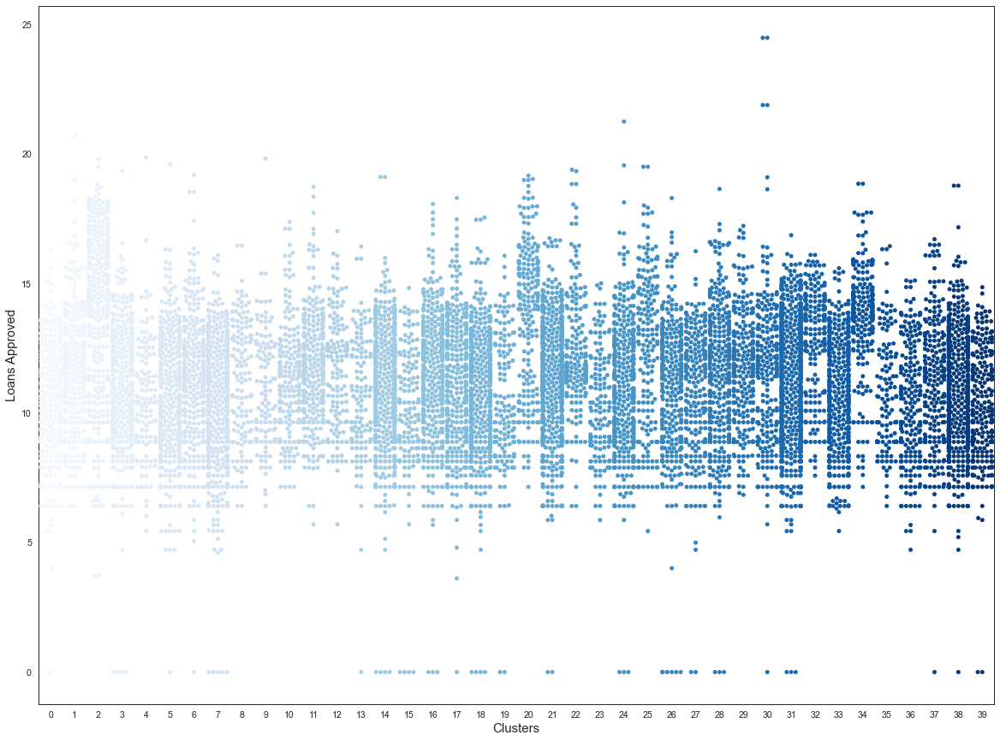

In [94]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_nonzero, x="Cluster_fast_U", y="loans_approved",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Loans Approved', fontsize = 15)

plt.show()

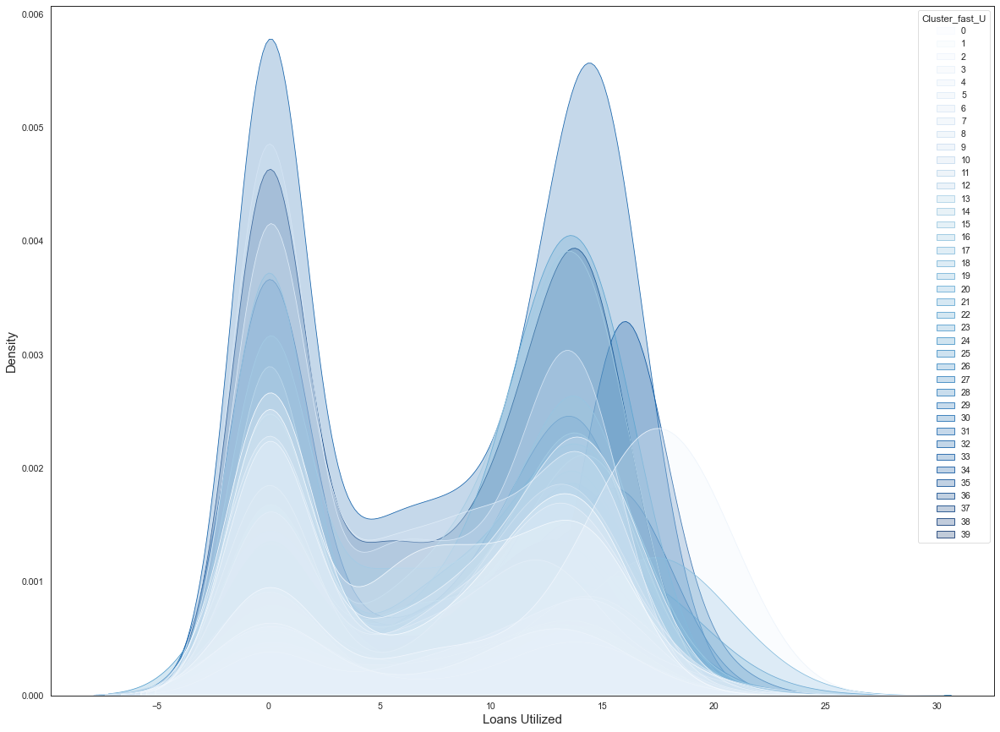

In [95]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the kdeplot and set the font

j= sns.kdeplot(data=tra_nonzero, x="loans_utilized", hue="Cluster_fast_U", palette=('Blues'), shade=True)
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Loans Utilized', fontsize = 15)
ax.set_ylabel('Density', fontsize = 15)

plt.show()

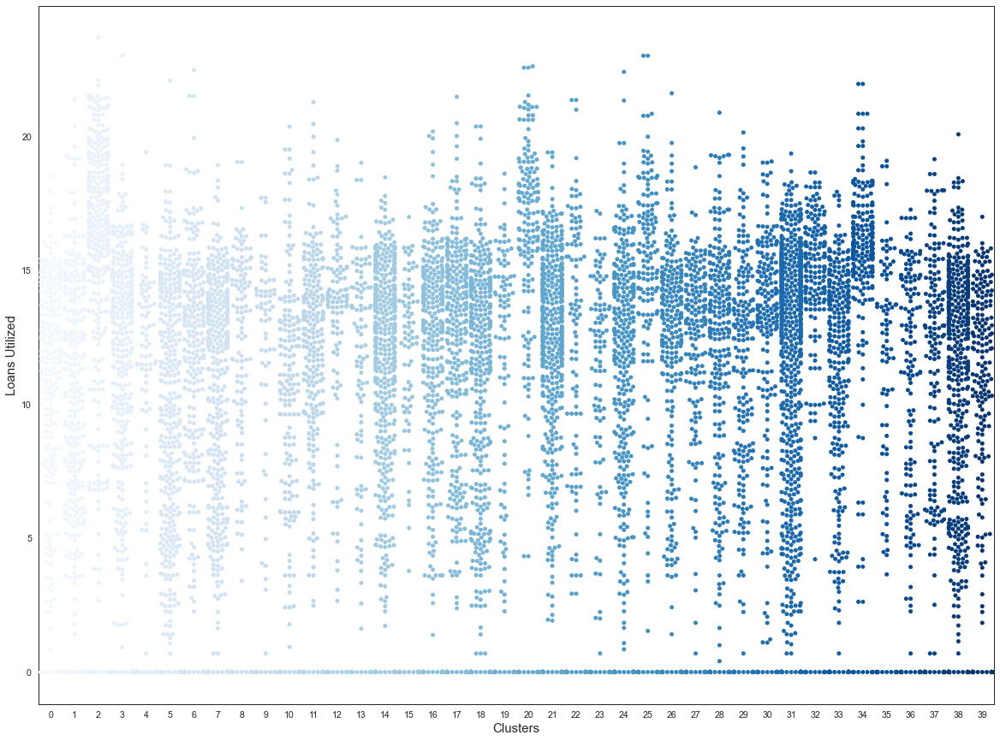

In [96]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_nonzero, x="Cluster_fast_U", y="loans_utilized",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Loans Utilized', fontsize = 15)

plt.show()

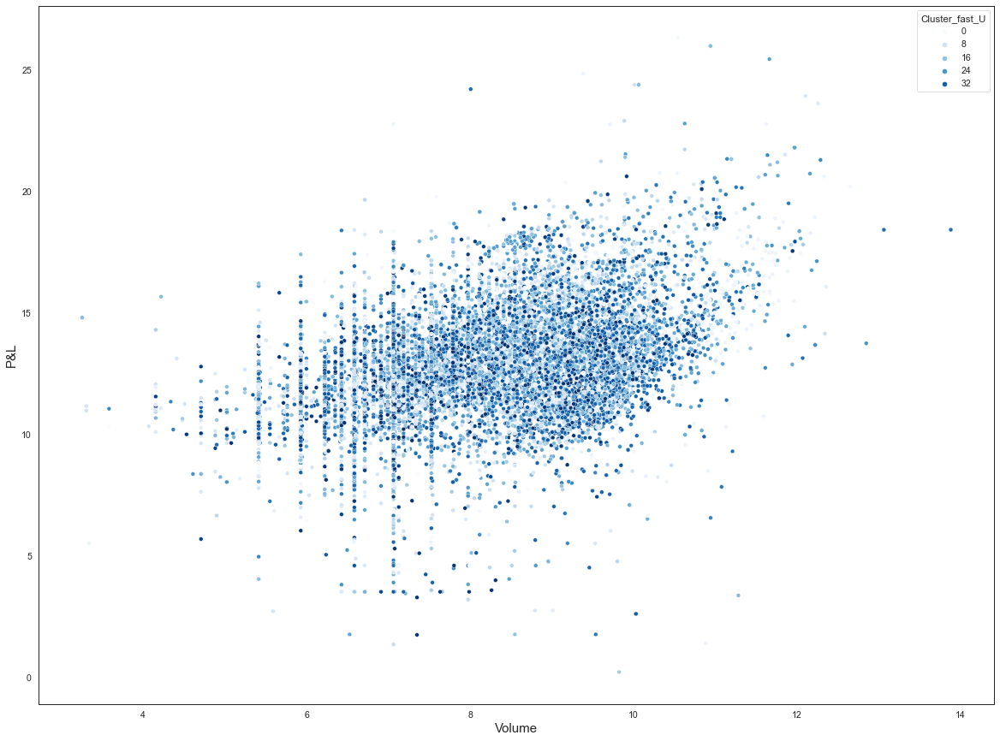

In [97]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the scatterplot and set the font

j= sns.scatterplot(data=tra_nonzero, x='volume', y='pl', hue='Cluster_fast_U', palette=('Blues'), ax=ax)
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Volume', fontsize = 15)
ax.set_ylabel('P&L', fontsize = 15)

plt.show()

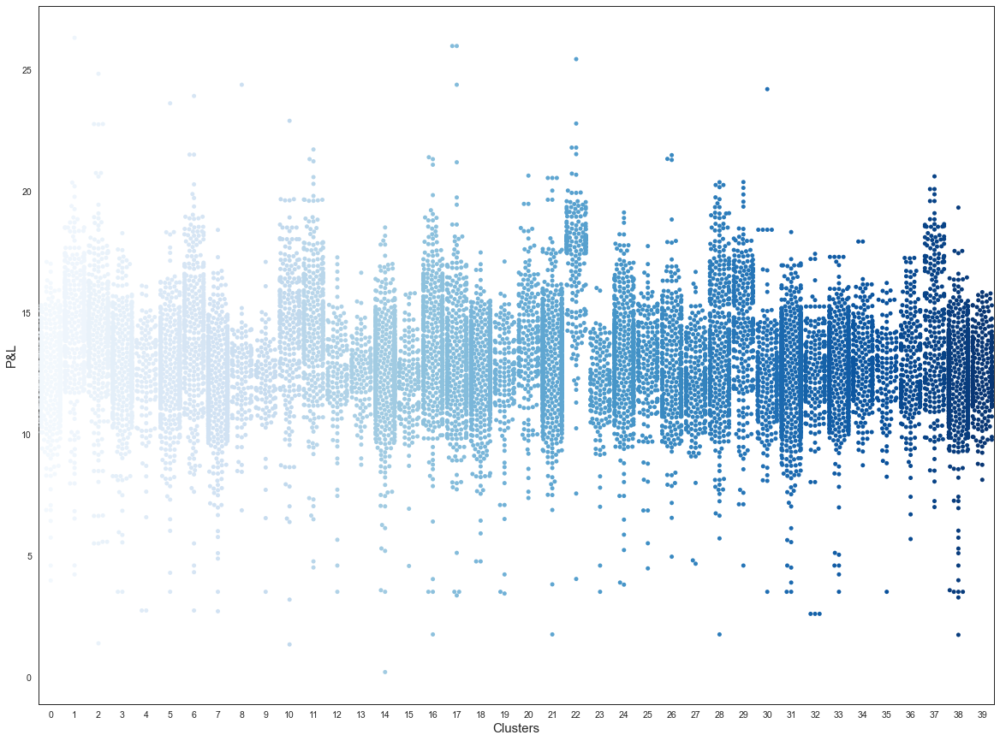

In [98]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_nonzero, x="Cluster_fast_U", y="pl",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('P&L', fontsize = 15)

plt.show()

Text(27.075000000000003, 0.5, 'Liabilities')

<Figure size 1440x1080 with 0 Axes>

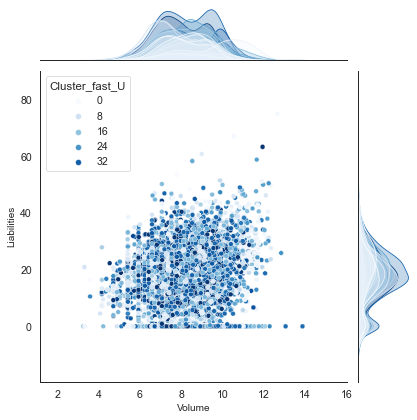

In [99]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")


plt.figure(figsize=(20,15))

# we develop the jointplot and specify the labels

j = sns.jointplot(data=tra_nonzero, x="volume", y="liabilities", hue="Cluster_fast_U", palette=('Blues'))
j.ax_joint.set_xlabel('Volume', fontsize = 10)
j.ax_joint.set_ylabel('Liabilities', fontsize = 10)

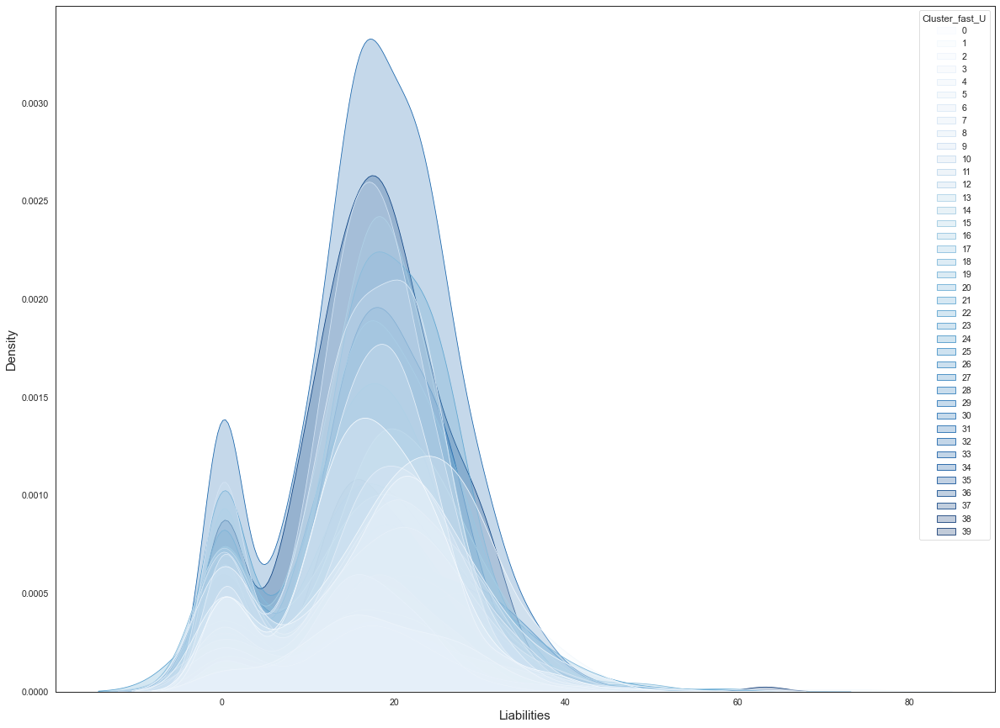

In [100]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the kdeplot and set the font

j= sns.kdeplot(data=tra_nonzero, x="liabilities", hue="Cluster_fast_U", palette=('Blues'), shade=True)
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Liabilities', fontsize = 15)
ax.set_ylabel('Density', fontsize = 15)

plt.show()

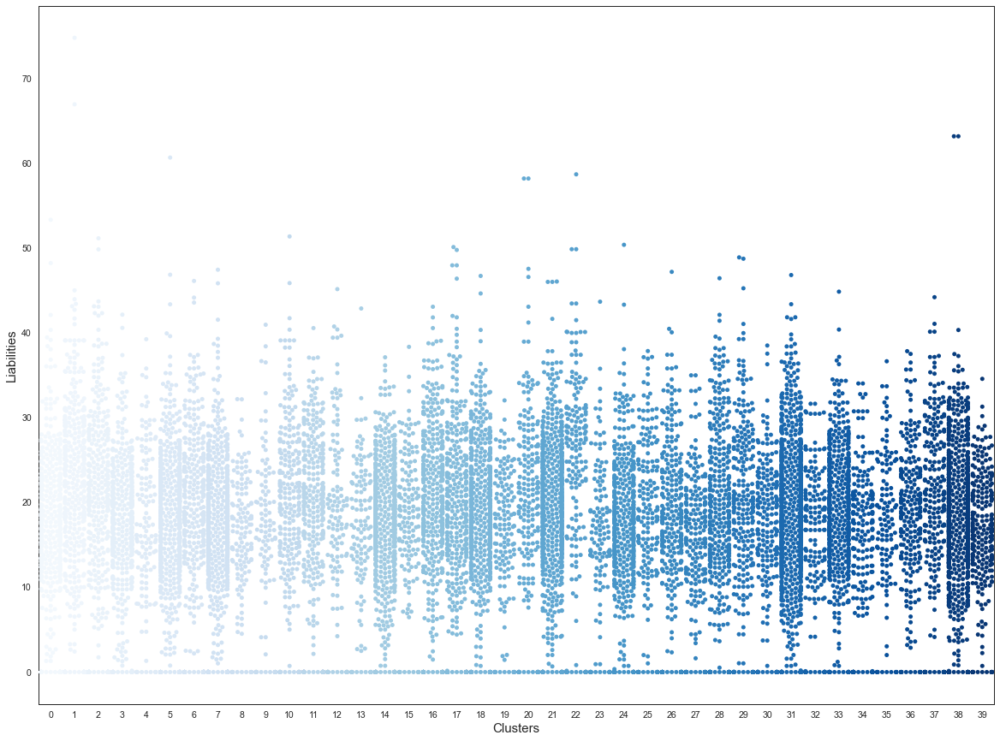

In [101]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_nonzero, x="Cluster_fast_U", y="liabilities",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Liabilities', fontsize = 15)

plt.show()

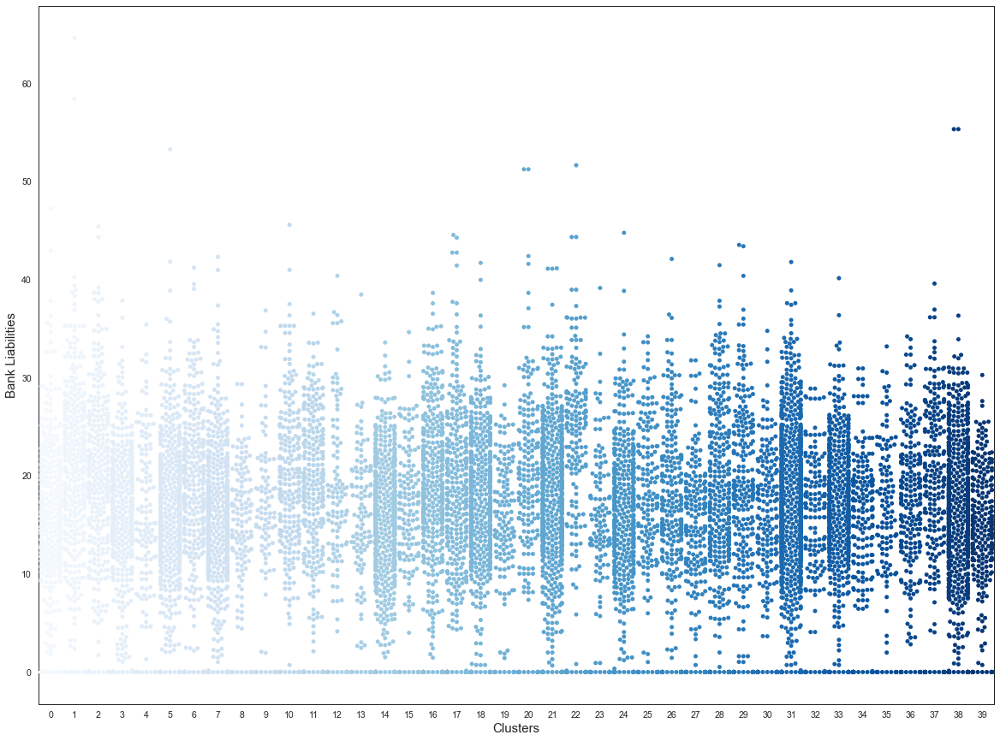

In [102]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the swarmplot and set the font

j= sns.swarmplot(data=tra_nonzero, x="Cluster_fast_U", y="bank_liabilities",  palette=('Blues'))
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Bank Liabilities', fontsize = 15)

plt.show()

In [103]:
# # set the basic format (i.e. the palette for the color and the backgrounds)
# sns.set(rc={'axes.facecolor':'white'})
# sns.set_context("paper", font_scale = 1.2)
# sns.set_style("white")
# #sns.set_palette("BrBG_r")

# # set the size of the plot
# fig, ax = plt.subplots(figsize=(20,15))


# #create the distplot and set the font
# j= sns.swarmplot(data=tra_nonzero, x="Cluster_fast_U", y="other_liabilities",  palette=('Blues'))
# sns.set(font_scale = 1)

# # Set title, labels and ticks to each subplot
# ax.set_xlabel('Clusters', fontsize = 15)
# ax.set_ylabel('Other Liabilities', fontsize = 15)

# plt.show()

In [104]:
# # set the basic format (i.e. the palette for the color and the backgrounds)
# sns.set(rc={'axes.facecolor':'white'})
# sns.set_context("paper", font_scale = 1.2)
# sns.set_style("white")
# #sns.set_palette("BrBG_r")

# # set the size of the plot
# fig, ax = plt.subplots(figsize=(20,15))


# #create the distplot and set the font
# j= sns.swarmplot(data=tra_nonzero, x="Cluster_fast_U", y="new_commission_income",  palette=('Blues'))
# sns.set(font_scale = 1)

# # Set title, labels and ticks to each subplot
# ax.set_xlabel('Clusters', fontsize = 15)
# ax.set_ylabel('Commission Income', fontsize = 15)

# plt.show()

##### Distribution of Non-Financial Features <a class="anchor" id="24"></a>

Next we compplement the research with an analysis of non-financial features.

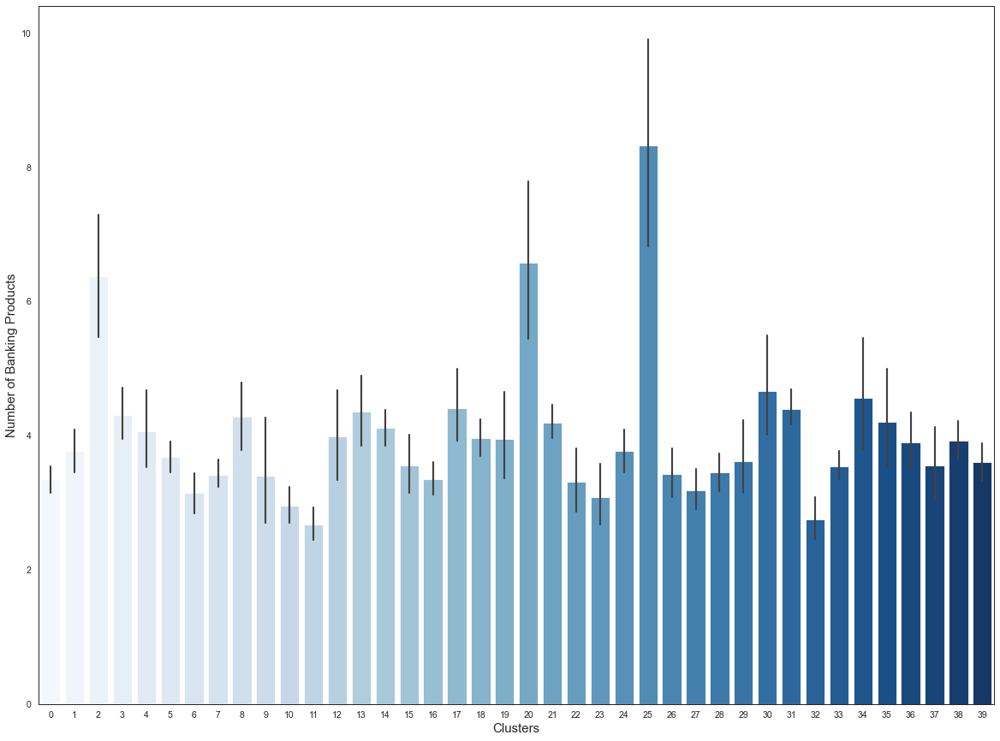

In [106]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the barplot and set the font

j= sns.barplot(x ='Cluster_fast_U', y ='banking_products', data = tra_nonzero, palette ='Blues')
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Number of Banking Products', fontsize = 15)

#plt.savefig('Bank_fast.png', dmi=1200)

plt.show()

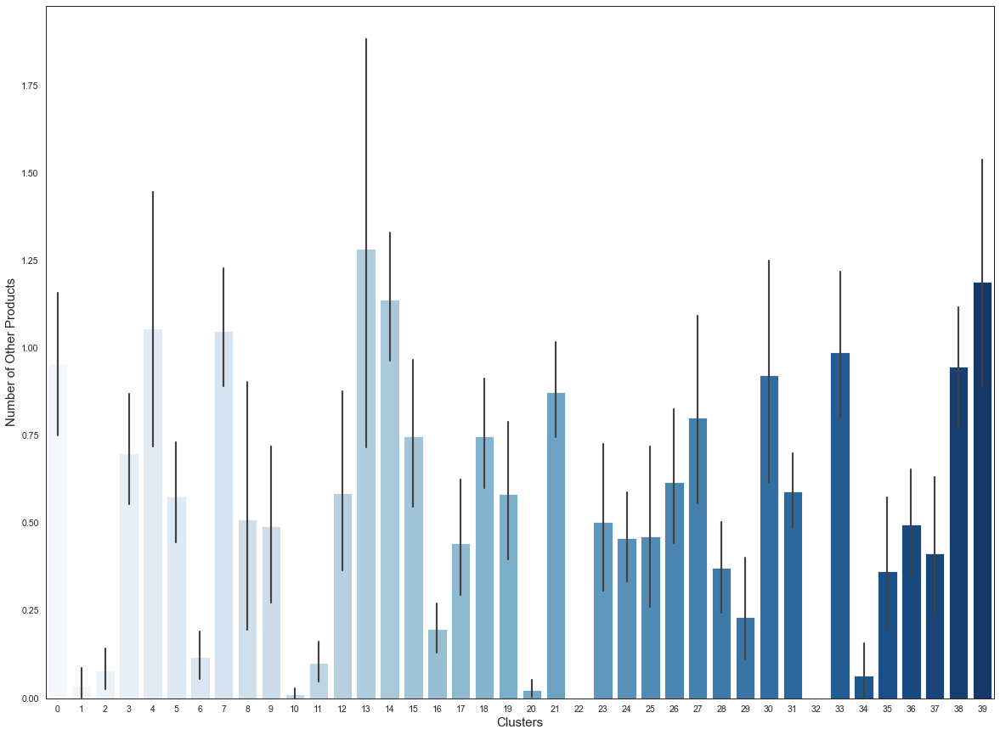

In [107]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the barplot and set the font

j= sns.barplot(x ='Cluster_fast_U', y ='other_products', data = tra_nonzero, palette ='Blues')
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Number of Other Products', fontsize = 15)

#plt.savefig('Other_fast.png', dmi=1200)

plt.show()

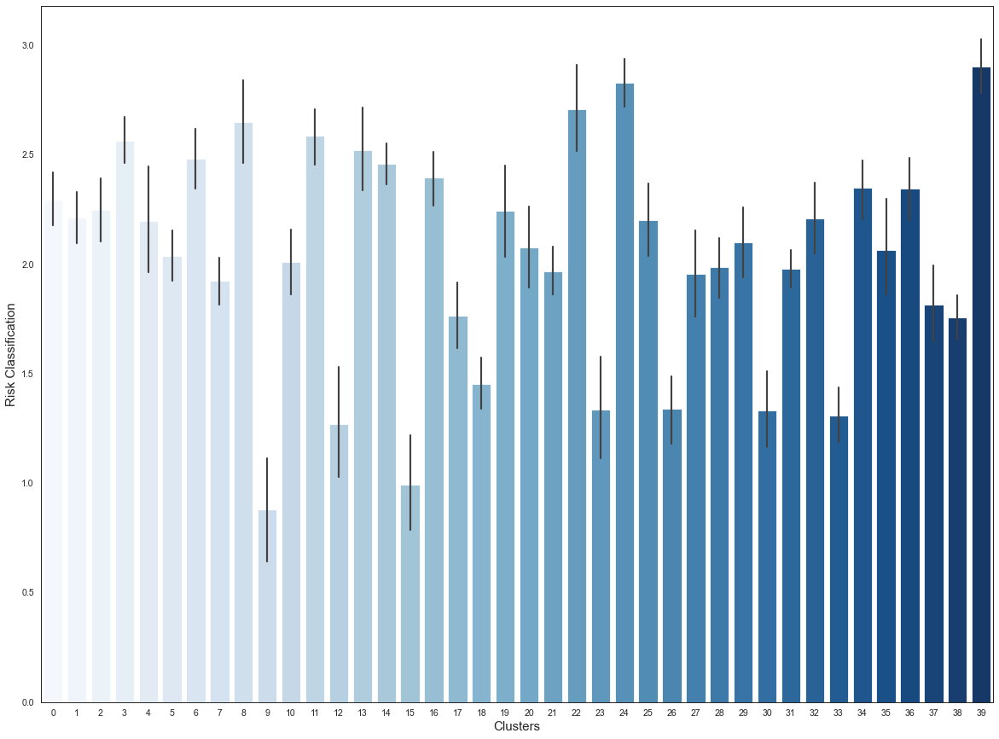

In [108]:
# set the basic format (i.e. the palette for the color and the backgrounds)

sns.set(rc={'axes.facecolor':'white'})
sns.set_context("paper", font_scale = 1.2)
sns.set_style("white")
#sns.set_palette("BrBG_r")

# set the size of the plot

fig, ax = plt.subplots(figsize=(20,15))


#create the barplot and set the font

j= sns.barplot(x ='Cluster_fast_U', y ='risk', data = tra_nonzero, palette ='Blues')
sns.set(font_scale = 1)

# Set title, labels and ticks to each subplot

ax.set_xlabel('Clusters', fontsize = 15)
ax.set_ylabel('Risk Classification', fontsize = 15)

#plt.savefig('Risky.png', dmi=1200)

plt.show()

<br>
<br>
<br>

<br>

### Summary of the Results <a class="anchor" id="24"></a> 

When assessing the two models, it is clear that both perform an exceptional job in segmenting the clients. Unlike the prior clusters, HAC and FasterPAM introduce more central features and do not only take into account clients from extreme sides of the spectrums. Specifically, when observing the distribution of averages per cluster it is visible that both depict clusters which are very different in their nature with differen and clear multidimensional demands. Moreover, both models clearly take into account the financial needs of the clients, developing clusters accordingly. When observing the distributions of P&L for the HAC model, the plots suggest that the clusters do not have anologous distirbutions and the different peaks suggest the firms within different clusters have specific financial characteristics. On top of that HAC does an excellent job in discerning amonsgt client liabilities too. As a result it can determine how liable different clusters and what prospected risks this might entail for the bank. When regarding the FasterPAM algorithm, this provides an even more detailed account of financial than HAC does. Precisly, the algorithm creates an optimal separation of clients based on credit (i.e. loans) with visibly different peaks. This is true even for loans approves and utilised. Furthermore, the algorithm suggests that the clusters have different P&L statements too, entailing very different financial healths. Consequentially this entails that FasterPAM can efficiently aid in predicting the credit requirements of the different clusters by determining what credit products (i.e. securities, bonds, etc.) are best suited for the clients according to howliable they are and how stable they can be in the near future. Lastly, both algorithms perform quite well with the non-financial features too, separating clients based on product utilisation and risk levels. As a result, this level of specificity in segmenting the clients suggests that both models should be adopted within a banking enviornment in order to aid core financial processes. Specifically, both algorithms can help financial analysts and relationship managers in developing credit and non-credit products, in pricing them accordingly and in understanding potential risks (i.e. credit, liquidity, etc.) and threats posed by the clients. These can further help in designining an encompassive portfolio strategy for each cluster, based on their respective strategic directions.